# Figures for manuscript - Treguier et al 2025 
Multidecadal Treds of the Mixed Layer Depth and their relation to the Wind in Global Ocena Models Forced by an Atmospheric Reanalysis

Datasets are assumed to be located in DATA_PAPER_2024 in the user's home directory.

Figures can be run independently unless otherwise indicated;

In [1]:
import os
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import scipy.stats as stats
import warnings
import cftime
from glob import glob
warnings.filterwarnings('ignore')
pathutil = os.environ['HOME']+'/PYTHON/PYUTILS'
#
#
dirin = os.environ['HOME']+'/DATA_PAPER_2024/'

# 1- global maps of interannual std 

Figure 1

Supplementary figures S1,S2,S3,S4

In [2]:
dsin=xr.open_dataset(dirin+'mld_interannual_std_models.nc')
                     # use 6 low res models only out of 8 to have model pairs
varlow=['NCAR-POP_low','IAP-LICOM_low','CMCC-NEMO_low','ACCESS-MOM_low',\
        'FSU-HYCOM_low','AWI-FESOM_low']
varhi=['NCAR-POP_hi','IAP-LICOM_hi','CMCC-NEMO_hi','ACCESS-MOM_hi',\
        'FSU-HYCOM_hi','AWI-FESOM_hi']
# compute multimodel means lowres, highres. 
dsmultilow=dsin[varlow[5]+'_std']
for ii in range(5) :
    dsmultilow=dsmultilow+dsin[varlow[ii]+'_std']
dsmultilow=dsmultilow/6.
dsmultihi=dsin[varhi[5]+'_std']
for ii in range(5) :
    dsmultihi=dsmultihi+dsin[varhi[ii]+'_std']
dsmultihi=dsmultihi/6.

In [3]:
# now compute multimodel std
#  construct a dataarray with imod as additional dimension
for ii,ivar in enumerate(varlow) :
    tabstd=dsin[ivar+'_std']
    tabstd=tabstd.expand_dims(dim='modnum',axis=0)
    tabstd=tabstd.assign_coords({"modnum":[ ii ]})
    if (ii == 0):
        dslow_mmstd=tabstd
    else :
        dslow_mmstd = xr.concat([dslow_mmstd,tabstd],dim="modnum")
for ii,ivar in enumerate(varhi) :
    tabstd=dsin[ivar+'_std']
    tabstd=tabstd.expand_dims(dim='modnum',axis=0)
    tabstd=tabstd.assign_coords({"modnum":[ ii ]})
    if (ii == 0):
        dshi_mmstd=tabstd
    else :
        dshi_mmstd = xr.concat([dshi_mmstd,tabstd],dim="modnum")
# Now I compute the multimodel std of stds
ds_mm_std=xr.Dataset()
ds_mm_std['low_mmstd']=dslow_mmstd.std('modnum')
ds_mm_std['hi_mmstd']=dslow_mmstd.std('modnum')
ds_mm_std

<xarray.Dataset> Size: 3MB
Dimensions:    (lat: 290, season: 2, lon: 360)
Coordinates:
  * lat        (lat) float64 2kB -80.05 -79.71 -79.38 ... 89.05 89.38 89.71
    labsea     (season) <U6 48B 'winter' 'summer'
  * lon        (lon) float64 3kB -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
  * season     (season) int64 16B 0 1
Data variables:
    low_mmstd  (season, lat, lon) float64 2MB nan nan nan ... 1.275 1.273 1.274
    hi_mmstd   (season, lat, lon) float64 2MB nan nan nan ... 1.275 1.273 1.274

In [4]:
#read the txt file for ipcc temp seq. colormap
rgb_data_in_the_txt_file = np.loadtxt(pathutil+'/cmap_ipcc_temp_seq.txt')/256
#create the colormap
mymap = mcolors.LinearSegmentedColormap.from_list('colormap', rgb_data_in_the_txt_file)
mymap.set_bad(color='grey')  # Set color for NaN values
# prepare figure. Max for winter and summer 
mmax=[ 400, 25]
lonplt=dsin.lon.values
latplt=dsin.lat.values
labsea=dsin.labsea.values

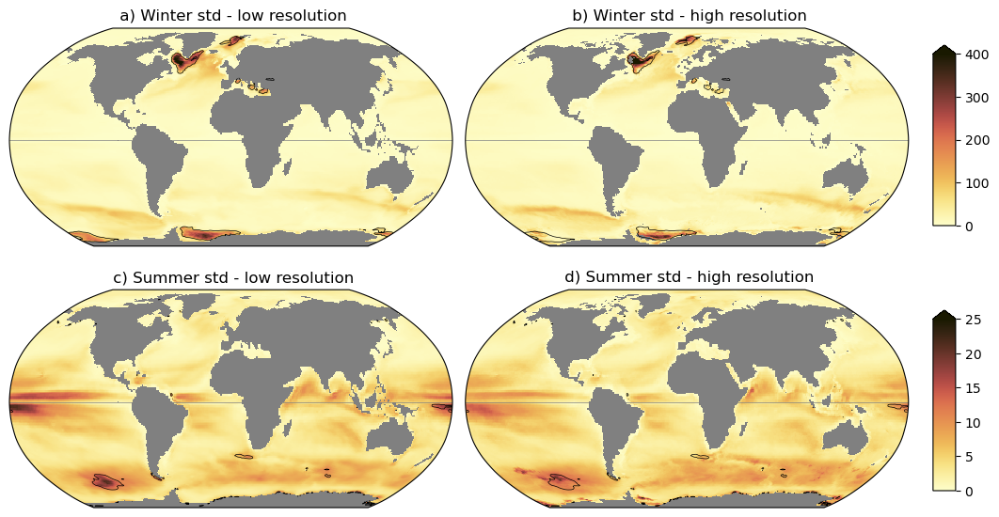

In [5]:
#  FIGURE 1 with linear colorbar 
mmax=[ 400, 25]
mstd=[ 100, 5]
mycol = 'k'
mylw=0.5
fig, axs = plt.subplots(nrows=2,ncols=2,
                        subplot_kw={'projection': ccrs.Robinson()},
                        figsize=(12,6))
#  Winter
isea=0
ax = axs[0,0]
pcm1 = ax.pcolormesh(lonplt,latplt,dsmultilow.isel(season=isea),vmin=0,vmax=mmax[isea],\
                    cmap=mymap,transform = ccrs.PlateCarree())
pcm = ax.contour(lonplt,latplt,ds_mm_std['low_mmstd'].isel(season=isea),levels=[mstd[isea]],\
                     colors=mycol,linewidths=mylw,transform = ccrs.PlateCarree())
ax.plot([ -180,180],[0,0],linewidth=0.5,color='gray',transform = ccrs.PlateCarree())
ax.set_title(' a) Winter std - low resolution')
ax = axs[0,1]
pcm1 = ax.pcolormesh(lonplt,latplt,dsmultihi.isel(season=isea),vmin=0,vmax=mmax[isea],\
                    cmap=mymap,transform = ccrs.PlateCarree())
pcm = ax.contour(lonplt,latplt,ds_mm_std['hi_mmstd'].isel(season=isea),levels=[mstd[isea]],\
                     colors=mycol,linewidths=mylw,transform = ccrs.PlateCarree())
ax.plot([ -180,180],[0,0],linewidth=0.5,color='gray',transform = ccrs.PlateCarree())
ax.set_title(' b) Winter std - high resolution')

#  Summer
isea=1
ax = axs[1,0]
pcm2 = ax.pcolormesh(lonplt,latplt,dsmultilow.isel(season=isea),vmin=0,vmax=mmax[isea],\
                    cmap=mymap,transform = ccrs.PlateCarree())
pcm = ax.contour(lonplt,latplt,ds_mm_std['low_mmstd'].isel(season=isea),levels=[mstd[isea]],\
                     colors=mycol,linewidths=mylw,transform = ccrs.PlateCarree())
ax.plot([ -180,180],[0,0],linewidth=0.5,color='gray',transform = ccrs.PlateCarree())
ax.set_title(' c) Summer std - low resolution')
ax = axs[1,1]
pcm2 = ax.pcolormesh(lonplt,latplt,dsmultihi.isel(season=isea),vmin=0,vmax=mmax[isea],\
                    cmap=mymap,transform = ccrs.PlateCarree())
pcm = ax.contour(lonplt,latplt,ds_mm_std['hi_mmstd'].isel(season=isea),levels=[mstd[isea]],\
                     colors=mycol,linewidths=mylw,transform = ccrs.PlateCarree())
ax.plot([ -180,180],[0,0],linewidth=0.5,color='gray',transform = ccrs.PlateCarree())
ax.set_title(' d) Summer std - high resolution')
# Adjust the location of the subplots on the page to make room for the colorbar
fig.subplots_adjust(bottom=0.05, top=0.9, left=0.1, right=0.9,
                    wspace=0.02, hspace=0.2)
# Add a colorbar axis at the top right for winter
cbar_ax = fig.add_axes([0.92, 0.55, 0.02, 0.32])
# Draw the colorbar
cbar=fig.colorbar(pcm1, cax=cbar_ax,orientation='vertical',extend='max')
# Add a colorbar axis at the bottom right for summer
cbar_ax = fig.add_axes([0.92, 0.08, 0.02, 0.32])
# Draw the colorbar
cbar=fig.colorbar(pcm2, cax=cbar_ax,orientation='vertical',extend='max')
plt.show()
fig.savefig('figures/f01.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')
fig.savefig('figures/f01_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')

##  now all individual models for supplementary material 


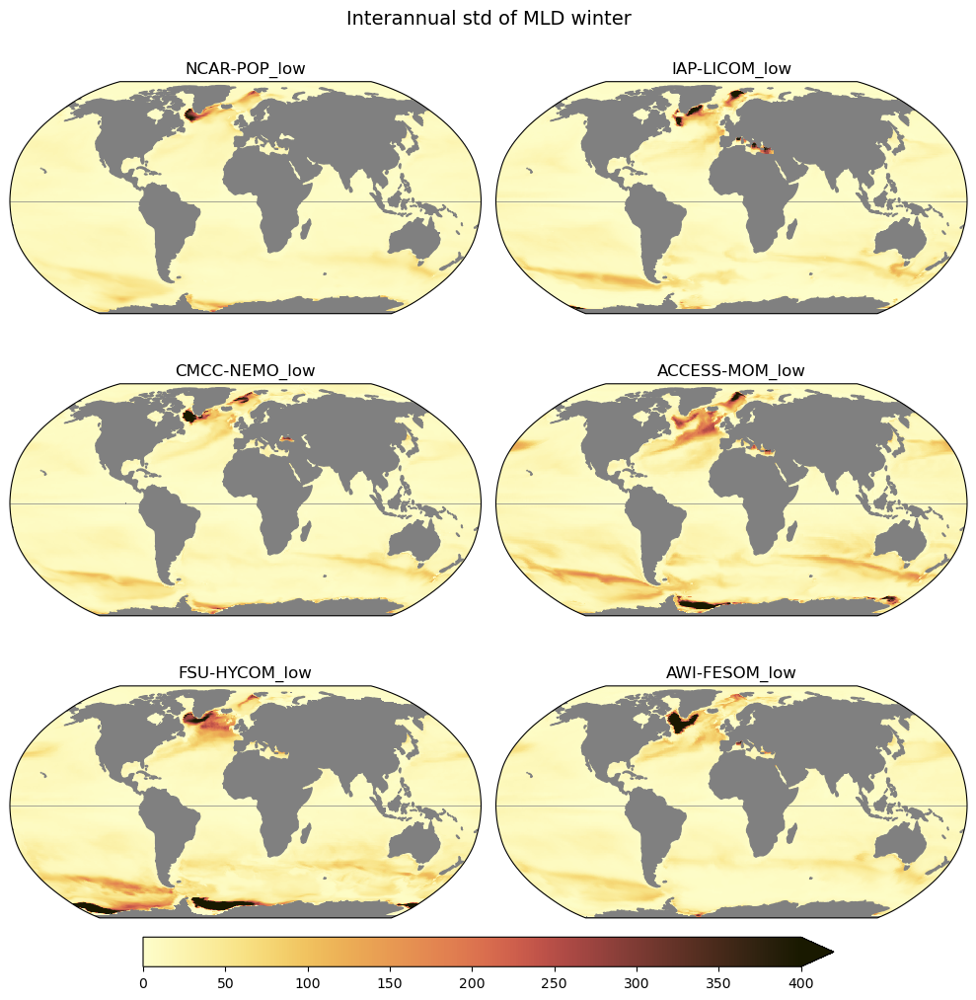

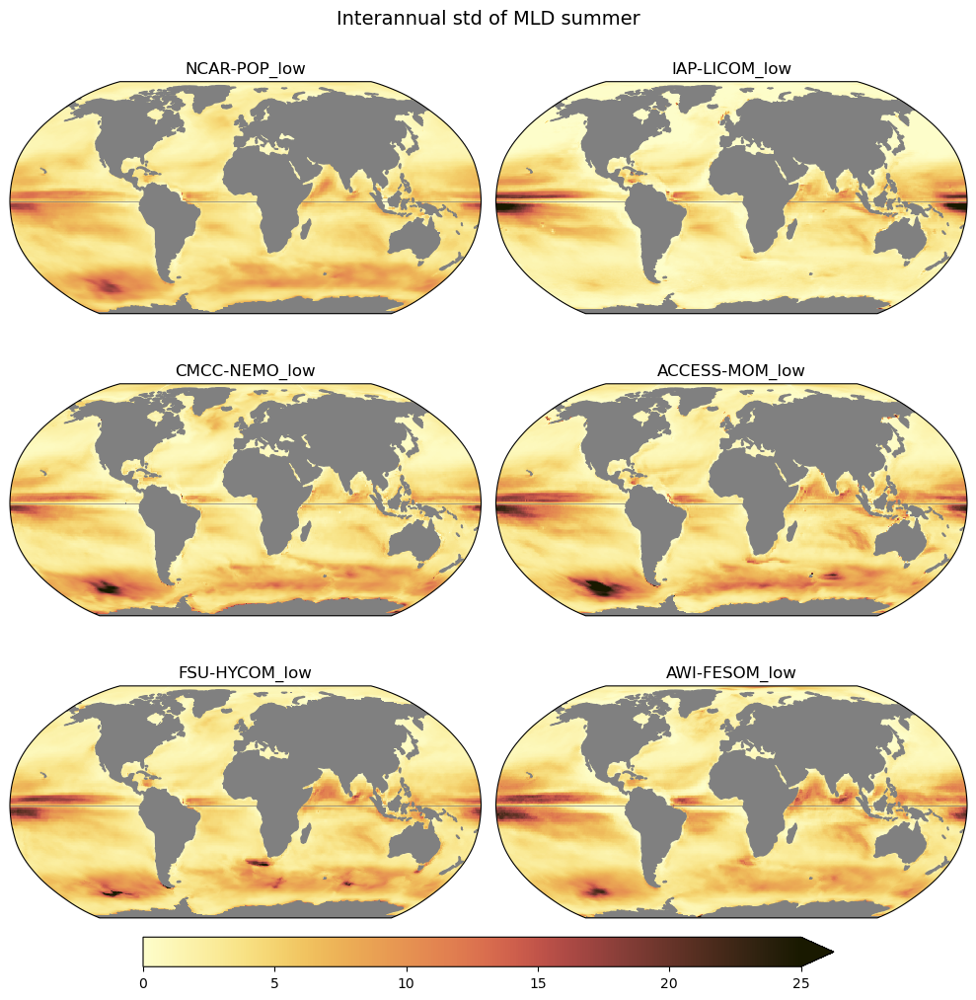

In [6]:
# plot std lowres models 
#  for two seasons, 6 models
figname=['S1_std_lowres_winter','S2_std_lowres_summer']
tabseason=list(dsin.labsea.values)
for isea in range (2) : 
    fig = plt.figure(figsize=(10,10))
    fig.suptitle('Interannual std of MLD '+tabseason[isea],fontsize=14)
    for imod in range(6) :
        ax = fig.add_subplot(3, 2, imod+1, projection=ccrs.Robinson())       
        modname =varlow[imod]
        #  plot standard deviation 
        tabplt=dsin[modname+'_std'].isel(season=isea)
        pcm=plt.pcolormesh(lonplt,latplt,tabplt,cmap=mymap,vmin=0,vmax=mmax[isea],
                          transform=ccrs.PlateCarree(),zorder=1)
        ax.plot([ -180,180],[0,0],linewidth=0.5,color='gray',transform = ccrs.PlateCarree())
        plt.title(modname)
        ax.add_feature(cfeature.LAND, edgecolor='grey', facecolor='grey',zorder=2)
#         fig.colorbar(pcm, ax=axs.ravel().tolist(),shrink=0.8,location='bottom')
#    fig.subplots_adjust(bottom=0.2)
    cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.03])
    fig.colorbar(pcm, cax=cbar_ax,orientation='horizontal',extend='max')
    fig.tight_layout()    
    plt.show()
    fig.savefig('figures/'+figname[isea]+'.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')
    fig.savefig('figures/'+figname[isea]+'_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')

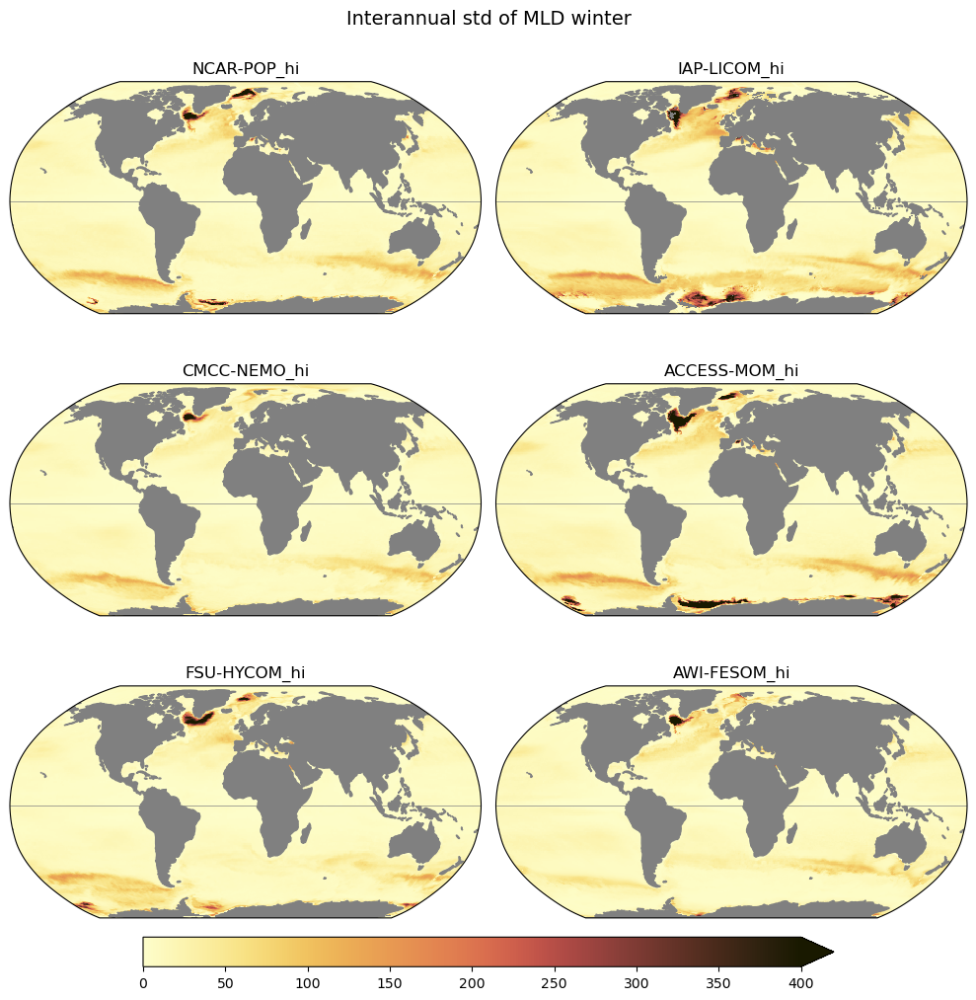

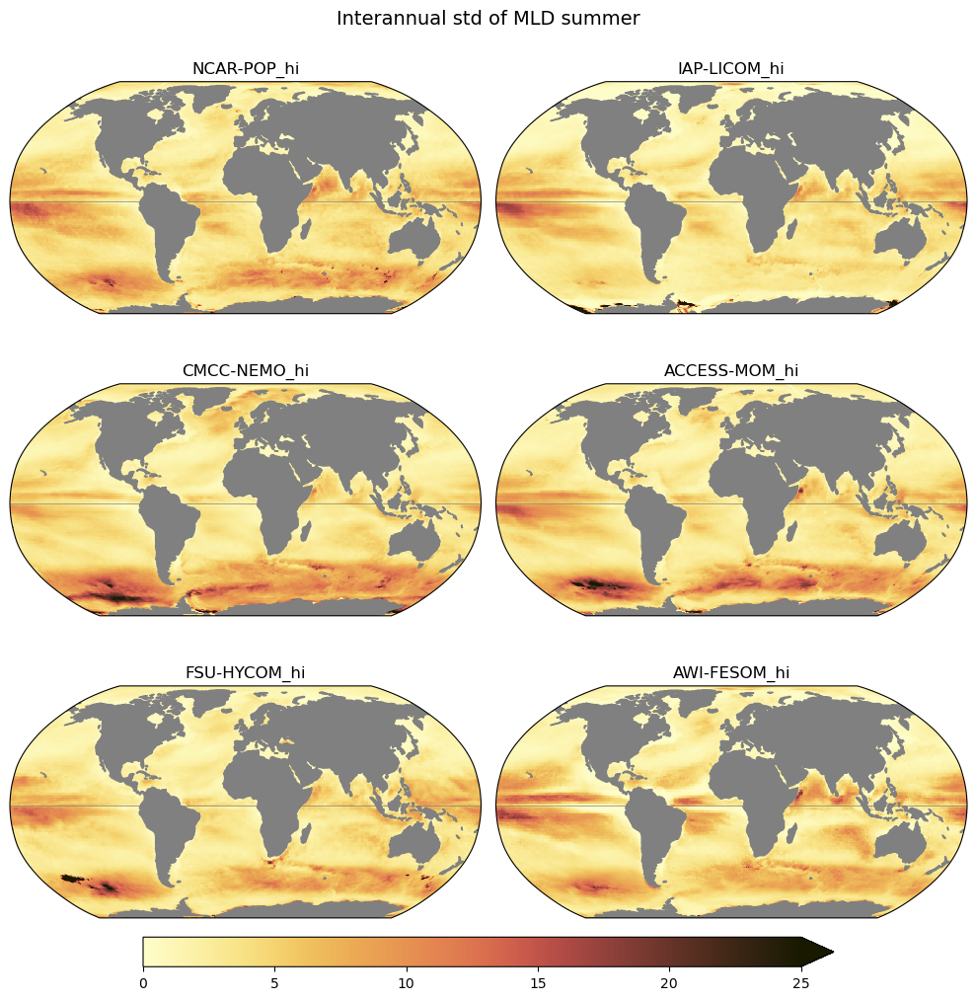

In [7]:
# plot std hires models 
#  for two seasons, 6 models
figname=['S3_std_hires_winter','S4_std_hires_summer']
for isea in range (2) : 
    fig = plt.figure(figsize=(10,10))
    fig.suptitle('Interannual std of MLD '+tabseason[isea],fontsize=14)
    for imod in range(6) :
        ax = fig.add_subplot(3, 2, imod+1, projection=ccrs.Robinson())       
        modname =varhi[imod]
        #  plot standard deviation 
        tabplt=dsin[modname+'_std'].isel(season=isea)
        pcm=plt.pcolormesh(lonplt,latplt,tabplt,cmap=mymap,vmin=0,vmax=mmax[isea],
                          transform=ccrs.PlateCarree(),zorder=1)
        ax.plot([ -180,180],[0,0],linewidth=0.5,color='gray',transform = ccrs.PlateCarree())
        plt.title(modname)
        ax.add_feature(cfeature.LAND, edgecolor='grey', facecolor='grey',zorder=2)
#         fig.colorbar(pcm, ax=axs.ravel().tolist(),shrink=0.8,location='bottom')
#    fig.subplots_adjust(bottom=0.2)
    cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.03])
    fig.colorbar(pcm, cax=cbar_ax,orientation='horizontal',extend='max')
    fig.tight_layout()    
    plt.show()
    fig.savefig('figures/'+figname[isea]+'.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')
    fig.savefig('figures/'+figname[isea]+'_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')

# 2 -  Inter-model correlations 

Figure 2 

Supplementary figures  S5, S6, S7, S8, S9, S10


In [8]:
# read the correlations for figure 2
dscorr=xr.open_dataset(dirin+'mld_interannual_correl_models.nc')                 
dscorr

<xarray.Dataset> Size: 10MB
Dimensions:      (lat: 290, season: 2, lon: 360)
Coordinates:
    member_id    <U8 32B ...
  * lat          (lat) float64 2kB -80.05 -79.71 -79.38 ... 89.05 89.38 89.71
    labsea       (season) <U6 48B ...
  * lon          (lon) float64 3kB -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
  * season       (season) int64 16B 0 1
    param_name   <U6 24B ...
Data variables:
    corr_low     (season, lat, lon) float64 2MB ...
    mask_low     (season, lat, lon) int64 2MB ...
    corr_hi      (season, lat, lon) float64 2MB ...
    mask_hi      (season, lat, lon) int64 2MB ...
    corr_low_hi  (season, lat, lon) float64 2MB ...
    mask_low_hi  (season, lat, lon) int64 2MB ...

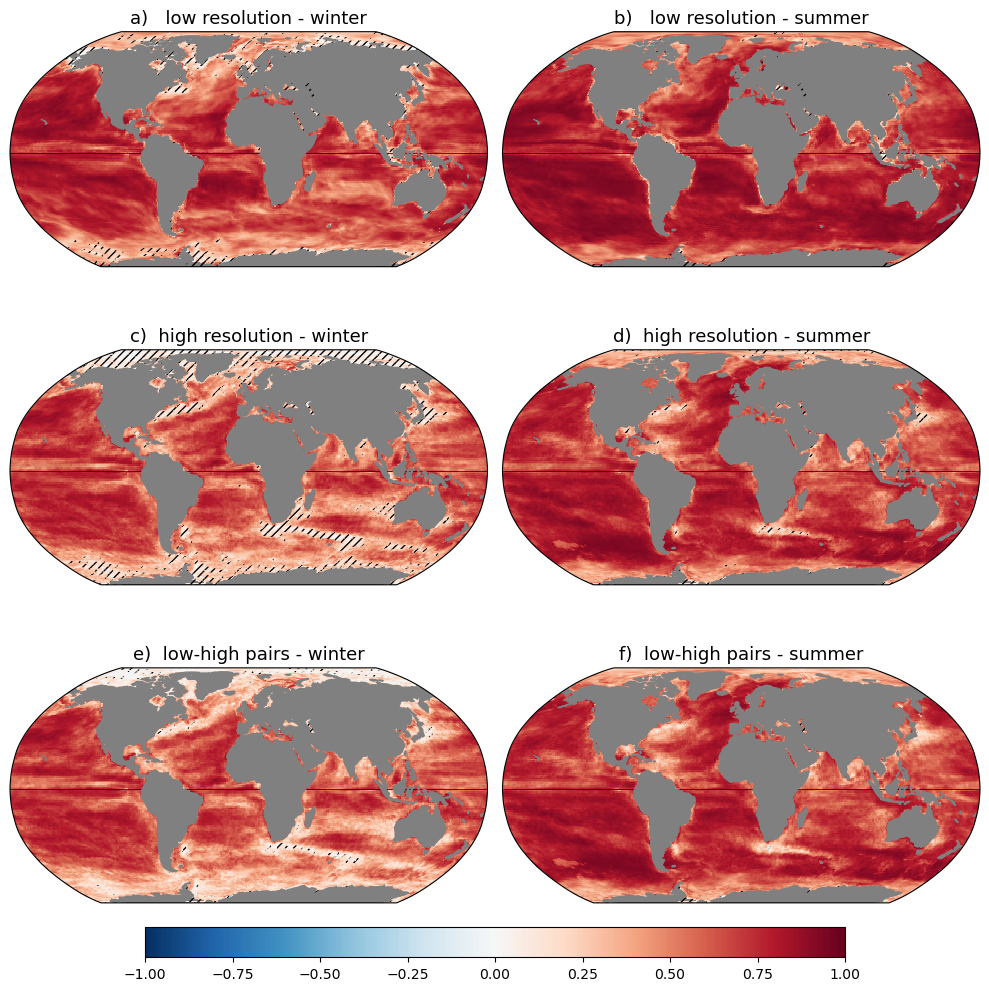

In [9]:
# now plots correlations: winter and summer, 3 variables. 
# add a mask. mask when at least half the pairs have pvalue >0.1
# thus the sum of the masks < 7.5 or < 3
myvars=['low','hi','low_hi']
maskval=[ 7.5, 7.5, 3]
mypanel=['a)  ','b)  ','c)  ','d)  ','e)  ','f)  ']  
titvar=[' low resolution','high resolution','low-high pairs']
mymap=plt.get_cmap('RdBu_r')
mymap.set_bad(color='grey')  # Set color for NaN values
lonplt=dscorr.lon.values
latplt=dscorr.lat.values
tabseason=list(dscorr.labsea.values)
fig = plt.figure(figsize=(10,10))
for isea in range (2) : 
    for ivar in range(3) :
        ax = fig.add_subplot(3, 2, ivar*2+1+isea, projection=ccrs.Robinson())       
        tabplt = dscorr['corr_'+myvars[ivar]].isel(season=isea)
        pcm=plt.pcolormesh(lonplt,latplt,tabplt,cmap=mymap,vmin=-1.,vmax=1.0,
                          transform=ccrs.PlateCarree(),zorder=1)
        tabmask=dscorr['mask_'+myvars[ivar]].isel(season=isea) < maskval[ivar]
        ax.contourf(lonplt,latplt, tabmask, levels=[0.5, 1], colors='none', hatches=['////'],\
                    alpha=0,transform=ccrs.PlateCarree())
        plt.title(mypanel[ivar*2+isea]+titvar[ivar]+' - '+tabseason[isea],fontsize=13)
        ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
        ax.add_feature(cfeature.LAND, edgecolor='grey', facecolor='grey',zorder=2)
#         fig.colorbar(pcm, ax=axs.ravel().tolist(),shrink=0.8,location='bottom')
#    fig.subplots_adjust(bottom=0.2)
cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.03])
fig.colorbar(pcm, cax=cbar_ax,orientation='horizontal')
fig.tight_layout()
plt.show()
fig.savefig('figures/f02_correl.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')
fig.savefig('figures/f02_correl_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')

In [10]:
#  for supplementary material 
#   pairwise correlations for low resolution models 
dscorr_all_low=xr.open_dataset(dirin+'mld_15_correl_lowres_models.nc')                 
# now plots correlations: winter and summer, 3 variables. 
#
myvars=list(dscorr_all_low.keys())
mymap=plt.get_cmap('RdBu_r')
mymap.set_bad(color='grey')  # Set color for NaN values
lonplt=dscorr_all_low.lon.values
latplt=dscorr_all_low.lat.values
tabseason=list(dscorr_all_low.labsea.values)

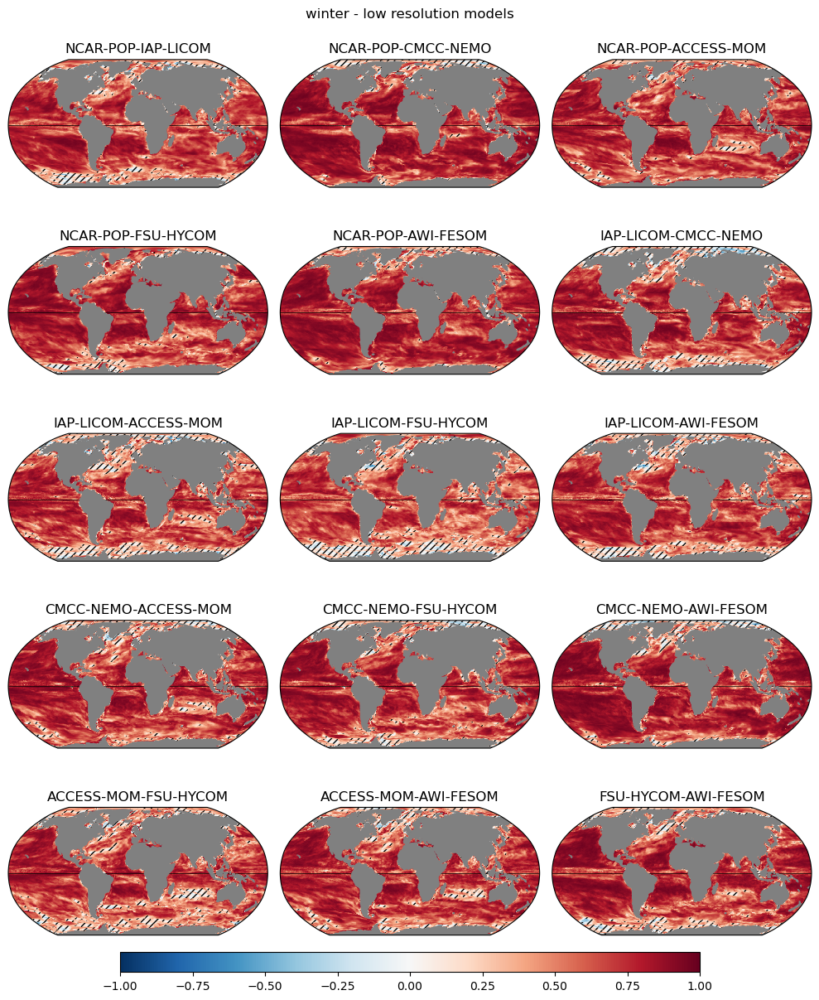

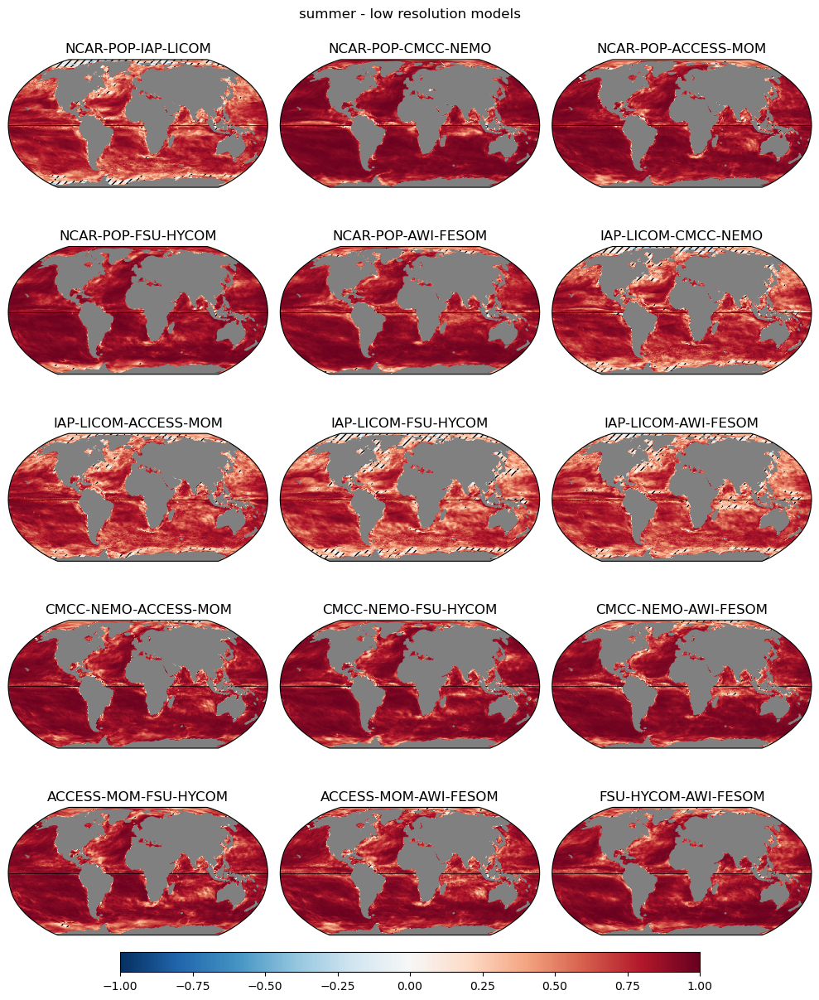

In [11]:
# loop on seasons: figures S5 and S6 
for isea in range (2) : 
    fig = plt.figure(figsize=(10,12))
    fig.suptitle(tabseason[isea]+' - low resolution models')
    for ivar in range(15) :
        ax = fig.add_subplot(5, 3, ivar+1, projection=ccrs.Robinson())       
        tabplt = dscorr_all_low[myvars[ivar]].isel(season=isea,parameter=0)
        pcm=ax.pcolormesh(lonplt,latplt,tabplt,cmap=mymap,vmin=-1.,vmax=1.0,
                          transform=ccrs.PlateCarree(),zorder=1)
        ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
        ax.add_feature(cfeature.LAND, edgecolor='grey', facecolor='grey',zorder=2)
        tabmask=dscorr_all_low[myvars[ivar]].isel(season=isea,parameter=1) > 0.1
        ax.contourf(lonplt,latplt, tabmask, levels=[0.5, 1], colors='none', hatches=['////'],\
                    alpha=0,transform=ccrs.PlateCarree())
        plt.title(myvars[ivar].replace('_low',''))
#         fig.colorbar(pcm, ax=axs.ravel().tolist(),shrink=0.8,location='bottom')
#    fig.subplots_adjust(bottom=0.2)
    cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.02])
    fig.colorbar(pcm, cax=cbar_ax,orientation='horizontal')
    fig.tight_layout()
    plt.show()
    fig.savefig('figures/S'+str(5+isea)+'_15_correl_low_'+tabseason[isea]+'.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')
    fig.savefig('figures/S'+str(5+isea)+'_15_correl_low_'+tabseason[isea]+'_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')

In [12]:
#  for supplementary material 
#   pairwise correlations of high resolution models 
dscorr_all_hi=xr.open_dataset(dirin+'mld_15_correl_hires_models.nc')                 
# now plots correlations: winter and summer, 3 variables. 
#
myvars=list(dscorr_all_hi.keys())
mymap=plt.get_cmap('RdBu_r')
mymap.set_bad(color='grey')  # Set color for NaN values
lonplt=dscorr_all_hi.lon.values
latplt=dscorr_all_hi.lat.values
tabseason=list(dscorr_all_hi.labsea.values)

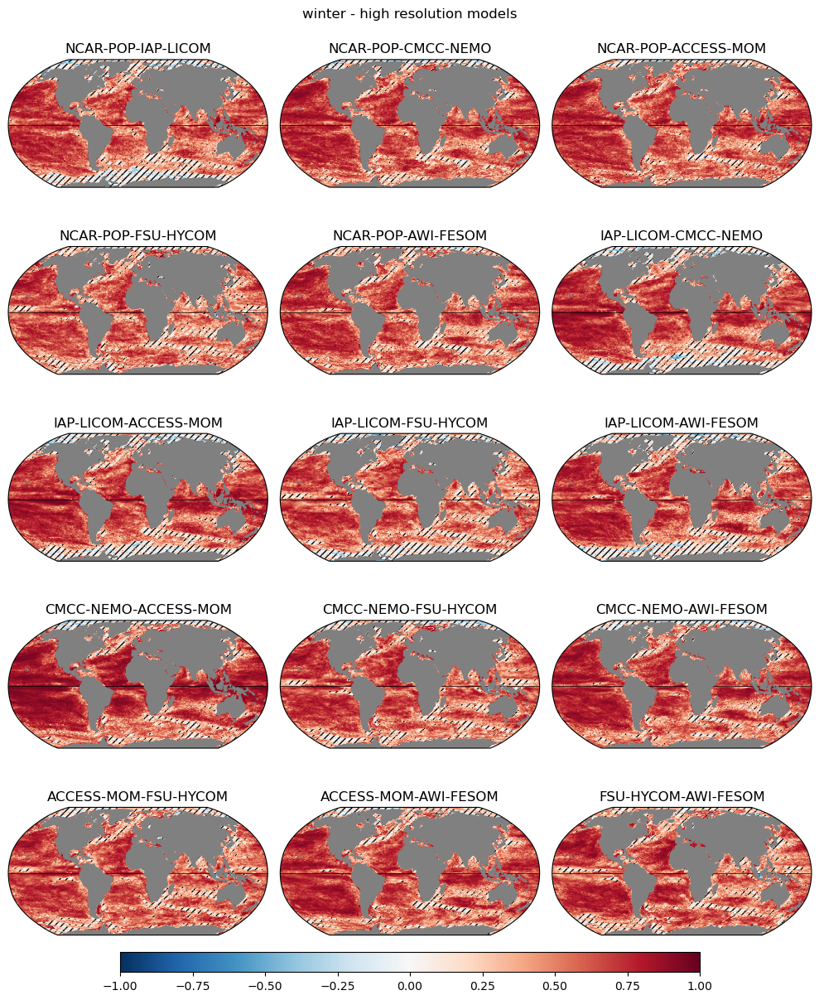

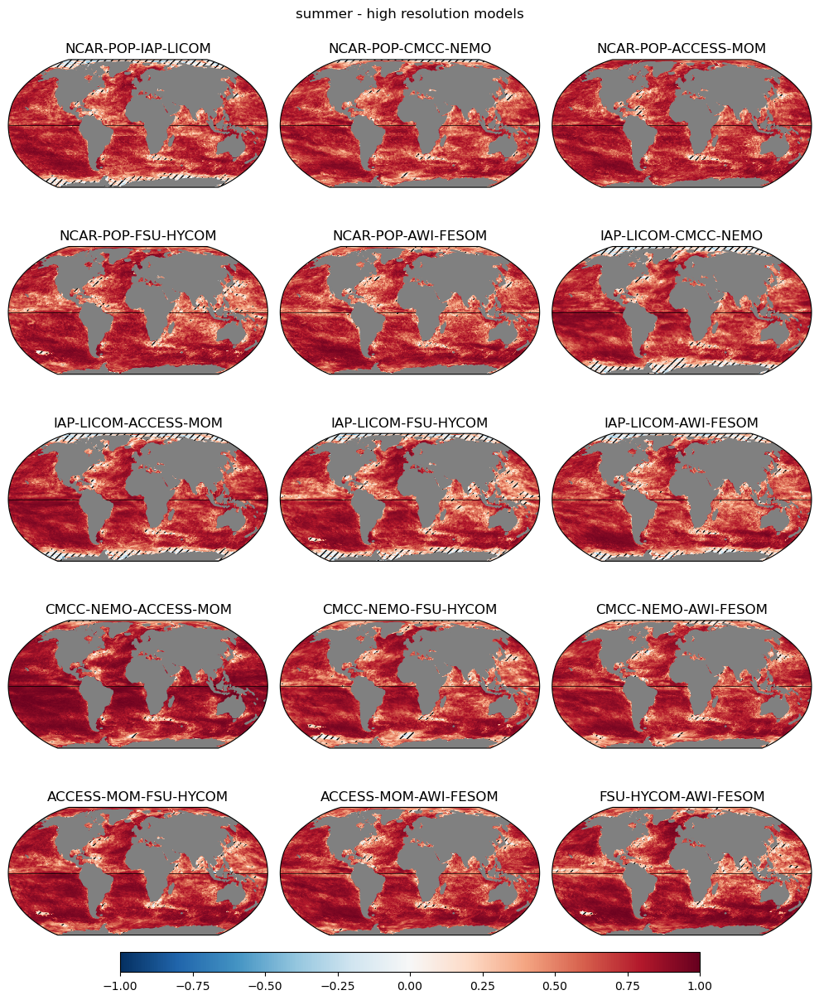

In [13]:
# loop on seasons: figures S7 and S8 
for isea in range (2) : 
    fig = plt.figure(figsize=(10,12))
    fig.suptitle(tabseason[isea]+' - high resolution models')
    for ivar in range(15) :
        ax = fig.add_subplot(5, 3, ivar+1, projection=ccrs.Robinson())       
        tabplt = dscorr_all_hi[myvars[ivar]].isel(season=isea,parameter=0)
        pcm=ax.pcolormesh(lonplt,latplt,tabplt,cmap=mymap,vmin=-1.,vmax=1.0,
                          transform=ccrs.PlateCarree(),zorder=1)
        ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
        ax.add_feature(cfeature.LAND, edgecolor='grey', facecolor='grey',zorder=2)
        tabmask=dscorr_all_hi[myvars[ivar]].isel(season=isea,parameter=1) > 0.1
        ax.contourf(lonplt,latplt, tabmask, levels=[0.5, 1], colors='none', hatches=['////'],\
                    alpha=0,transform=ccrs.PlateCarree())
        plt.title(myvars[ivar].replace('_hi',''))
#         fig.colorbar(pcm, ax=axs.ravel().tolist(),shrink=0.8,location='bottom')
#    fig.subplots_adjust(bottom=0.2)
    cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.02])
    fig.colorbar(pcm, cax=cbar_ax,orientation='horizontal')
    fig.tight_layout()
    plt.show()
    fig.savefig('figures/S'+str(7+isea)+'_15_correl_hi_'+tabseason[isea]+'.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')
    fig.savefig('figures/S'+str(7+isea)+'_15_correl_hi_'+tabseason[isea]+'_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')

In [14]:
# for supplementary material 
# correlations between low and high resolution members of each pair
filin=os.environ['HOME']+'/DATA_PAPER_2024/mld_correl_low_hi_models.nc'
dscorr_all=xr.open_dataset(filin)
myvars=list(dscorr_all.keys())
print(myvars)

['NCAR-POP', 'IAP-LICOM', 'CMCC-NEMO', 'ACCESS-MOM', 'FSU-HYCOM', 'AWI-FESOM', 'corr_low_hi']


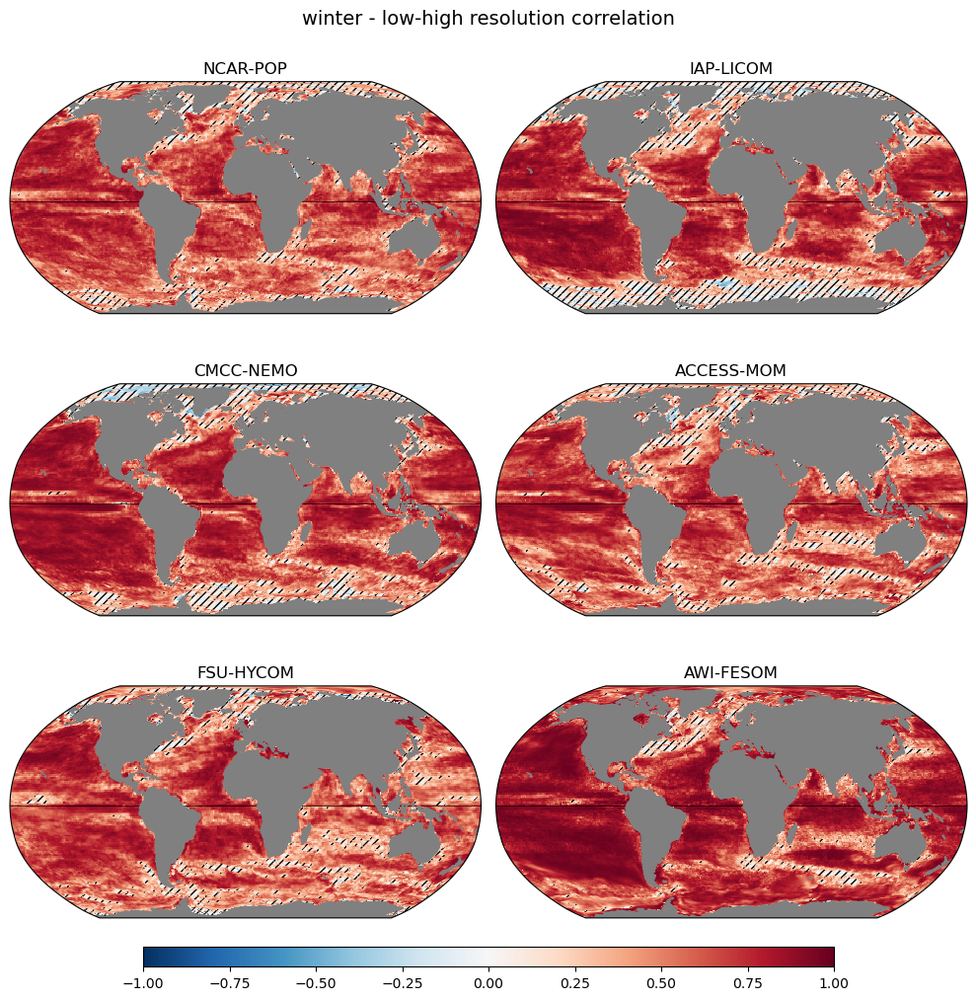

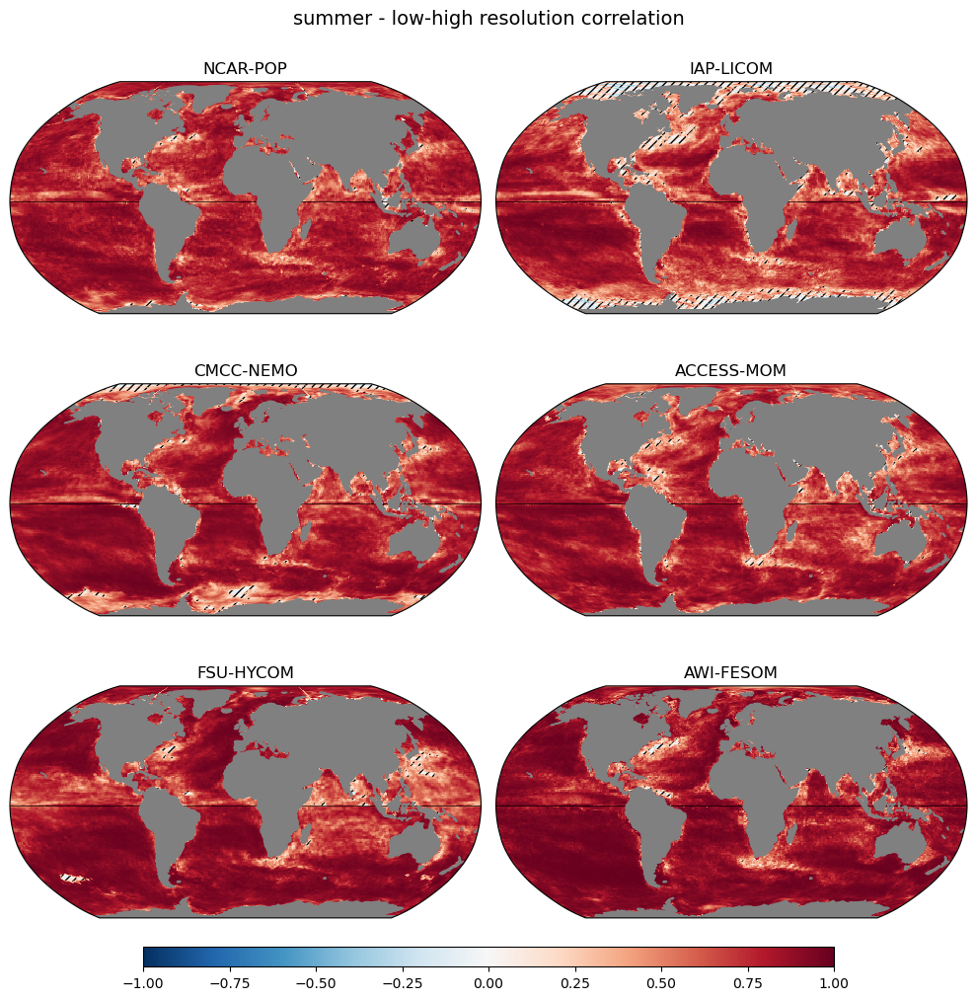

In [15]:
# loop on seasons: figures S9 and S10
for isea in range (2) : 
    fig = plt.figure(figsize=(10,10))
    fig.suptitle(tabseason[isea]+' - low-high resolution correlation',fontsize=14)
    for ivar in range(6) :
        ax = fig.add_subplot(3, 2, ivar+1, projection=ccrs.Robinson())       
        tabplt = dscorr_all[myvars[ivar]].isel(season=isea,parameter=0)
        pcm=plt.pcolormesh(lonplt,latplt,tabplt,cmap=mymap,vmin=-1.,vmax=1.0,
                          transform=ccrs.PlateCarree(),zorder=1)
        ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
        ax.add_feature(cfeature.LAND, edgecolor='grey', facecolor='grey',zorder=2)
        tabmask=dscorr_all[myvars[ivar]].isel(season=isea,parameter=1) > 0.1
        ax.contourf(lonplt,latplt, tabmask, levels=[0.5, 1], colors='none', hatches=['////'],\
                    alpha=0,transform=ccrs.PlateCarree())
        plt.title(myvars[ivar])
#         fig.colorbar(pcm, ax=axs.ravel().tolist(),shrink=0.8,location='bottom')
#    fig.subplots_adjust(bottom=0.2)
    cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.02])
    fig.colorbar(pcm, cax=cbar_ax,orientation='horizontal')
    fig.tight_layout()
    plt.show()
    fig.savefig('figures/S'+str(9+isea)+'_correl_low-hi_'+tabseason[isea]+'.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')
    fig.savefig('figures/S'+str(9+isea)+'_correl_low-hi_'+tabseason[isea]+'_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')

#  3 - Correlations with buoyancy flux and tau for CMCC model 

Figure 3 


In [16]:
dscorrf=xr.open_dataset(dirin+'CMCC_mld_correl_low_hi_forcing.nc')
dscorrf

<xarray.Dataset> Size: 13MB
Dimensions:            (lat: 290, season: 2, lon: 360, parameter: 2)
Coordinates:
  * lat                (lat) float64 2kB -80.05 -79.71 -79.38 ... 89.38 89.71
    labsea             (season) <U6 48B ...
  * lon                (lon) float64 3kB -179.5 -178.5 -177.5 ... 178.5 179.5
  * season             (season) int64 16B 0 1
Dimensions without coordinates: parameter
Data variables:
    CMCC_low_buoy_mld  (season, lat, lon, parameter) float64 3MB ...
    CMCC_low_tau_mld   (season, lat, lon, parameter) float64 3MB ...
    CMCC_hi_buoy_mld   (season, lat, lon, parameter) float64 3MB ...
    CMCC_hi_tau_mld    (season, lat, lon, parameter) float64 3MB ...

In [17]:
# read sea ice concentration
dsice=xr.open_dataset(dirin+'CMCC_mean_siconc.nc')
dsice

<xarray.Dataset> Size: 3MB
Dimensions:          (lat: 290, season: 2, lon: 360)
Coordinates:
    type             |S7 7B ...
  * lat              (lat) float64 2kB -80.05 -79.71 -79.38 ... 89.38 89.71
    labsea           (season) <U6 48B ...
  * lon              (lon) float64 3kB -179.5 -178.5 -177.5 ... 178.5 179.5
Dimensions without coordinates: season
Data variables:
    CMCC_siconc_low  (season, lat, lon) float64 2MB ...
    CMCC_siconc_hi   (season, lat, lon) float64 2MB ...

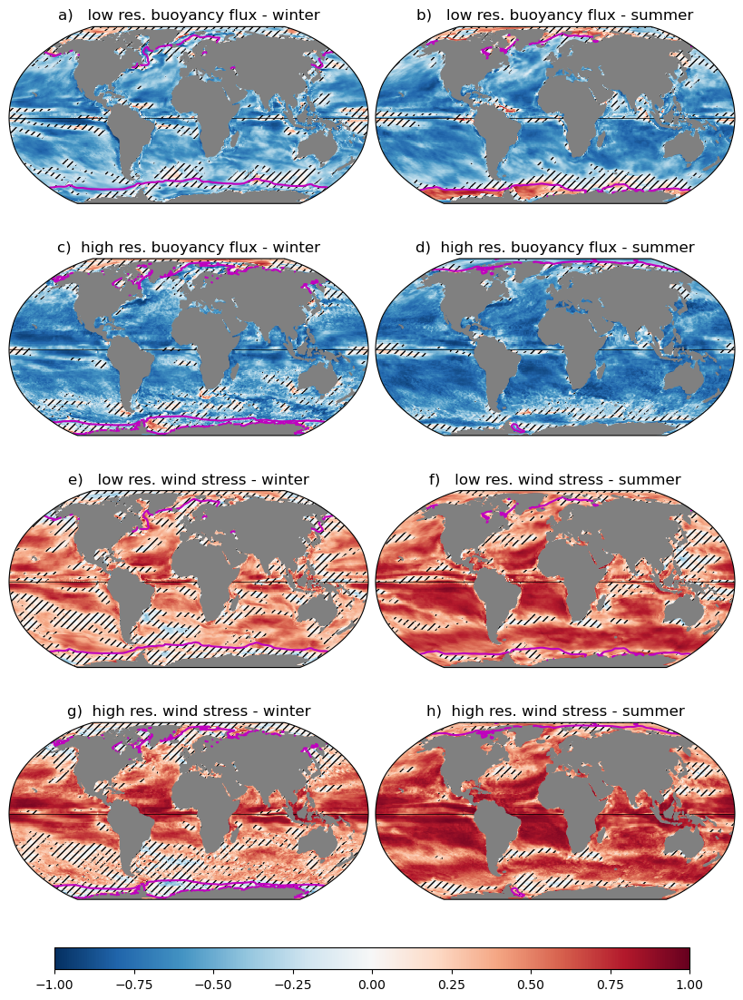

In [18]:
# now plots correlations: winter and summer, 4 variables. 
# FIGURE 3 
# verify the order of variables above. 
mypanel=['a)  ','b)  ','c)  ','d)  ','e)  ','f)  ','g)  ','h)  ']  
myvars=['CMCC_low_buoy_mld', 'CMCC_hi_buoy_mld','CMCC_low_tau_mld','CMCC_hi_tau_mld']
icevars=['CMCC_siconc_low','CMCC_siconc_hi','CMCC_siconc_low','CMCC_siconc_hi']
titvar=[' low res. buoyancy flux','high res. buoyancy flux',
         ' low res. wind stress','high res. wind stress' ]
mymap=plt.get_cmap('RdBu_r')
mymap.set_bad(color='grey')  # Set color for NaN values
lonplt=dscorrf.lon.values
latplt=dscorrf.lat.values
tabseason=list(dscorrf.labsea.values)
fig = plt.figure(figsize=(10,12))
for ivar in range(4) :
    for isea in range (2) : 
        ax = fig.add_subplot(4, 2, ivar*2+1+isea, projection=ccrs.Robinson())       
        tabplt = dscorrf[myvars[ivar]].isel(season=isea,parameter=0)
        dsi=dsice[icevars[ivar]].isel(season=isea)
        pcm=plt.pcolormesh(lonplt,latplt,tabplt,cmap=mymap,vmin=-1.,vmax=1.0,
                          transform=ccrs.PlateCarree(),zorder=1)
        plt.title(mypanel[ivar*2+isea]+titvar[ivar]+' - '+tabseason[isea])
        ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
        ax.add_feature(cfeature.LAND, edgecolor='grey', facecolor='grey',zorder=2)
        tabmask=dscorrf[myvars[ivar]].isel(season=isea,parameter=1) > 0.1
        ax.contourf(lonplt,latplt, tabmask, levels=[0.5, 1], colors='none', hatches=['////'],\
                    alpha=0,transform=ccrs.PlateCarree())
        ax.contour(lonplt,latplt,dsi,levels=[ 0.8],colors='m',transform=ccrs.PlateCarree())
#         fig.colorbar(pcm, ax=axs.ravel().tolist(),shrink=0.8,location='bottom')
fig.subplots_adjust(bottom=0.05, top=0.9, left=0.1, right=0.9,
                    wspace=0.02, hspace=0.01)

cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.02])
fig.colorbar(pcm, cax=cbar_ax,orientation='horizontal')
# fig.tight_layout()
plt.show()
fig.savefig('figures/f03_correl_cmcc_flux.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')
fig.savefig('figures/f03_correl_cmcc_flux_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')

#  4.  - Trends in wind speed

Figure 4: Trends of wind speed in winter and summer over the period 1970-2018, for ERA5 and JRA55do. 

Supplementary figure S11: compare trends of annual means of wind speed with the observations of Young and Ribal, over the same period (1985-2018).

##  4.1. Figure 4

In [19]:
#  read wind trends in reanalyses
dstrends=xr.open_dataset(os.environ['HOME']+'/DATA_PAPER_2024/JRA_uamp_trends_merc1.nc')
# read observed trends (Young and Ribal 2019)
ds_young=xr.open_dataset(os.environ['HOME']+'/DATA_PAPER_2024/Young_Ribal_U10_trend_1985_2018.nc')
# remove the extra longitude in this dataset
ds_young=ds_young.isel(lon=slice(0,180))
# roll to have Greenwich meridian in the middle. 
dtmp=dstrends
dtmp=dtmp.roll({'lon':dtmp.sizes['lon'] // 2},roll_coords=True)
dstrends=dtmp.assign_coords({'lon':(((dtmp['lon'] + 180) % 360) - 180)}) 
dtmp=ds_young
dtmp=dtmp.roll({'lon':dtmp.sizes['lon'] // 2},roll_coords=True)
ds_young=dtmp.assign_coords({'lon':(((dtmp['lon'] + 180) % 360) - 180)}) 
dstrends

<xarray.Dataset> Size: 21MB
Dimensions:   (lat: 290, lon: 360, parameter: 5, season: 2)
Coordinates:
  * lat       (lat) float64 2kB -80.05 -79.71 -79.38 ... 89.05 89.38 89.71
    labsea    (season) <U6 48B ...
  * lon       (lon) float64 3kB -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
Dimensions without coordinates: parameter, season
Data variables:
    uamp_34y  (lat, lon, parameter) float64 4MB nan nan nan ... 0.9779 0.003839
    uamp_49y  (season, lat, lon, parameter) float64 8MB nan nan ... 0.004509
    uamp_40y  (season, lat, lon, parameter) float64 8MB nan nan ... 0.005894

In [20]:
# READ eRA5 and roll
dtmp=xr.open_dataset(os.environ['HOME']+'/DATA_PAPER_2024/ERA5_U10_trends_merc1.nc')
dtmp=dtmp.roll({'lon':dtmp.sizes['lon'] // 2},roll_coords=True)
dstrendera=dtmp.assign_coords({'lon':(((dtmp['lon'] + 180) % 360) - 180)}) 
dstrendera

<xarray.Dataset> Size: 13MB
Dimensions:       (lat: 290, lon: 360, parameter: 5, season: 2)
Coordinates:
  * lat           (lat) float64 2kB -80.05 -79.71 -79.38 ... 89.05 89.38 89.71
    labsea        (season) <U6 48B ...
  * lon           (lon) float64 3kB -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
Dimensions without coordinates: parameter, season
Data variables:
    era5_U10_34y  (lat, lon, parameter) float64 4MB nan nan ... 0.8164 0.00534
    era5_U10_49y  (season, lat, lon, parameter) float64 8MB nan nan ... 0.005665

In [21]:
# average trend in latitude band 50-60
tabplt=dstrends['uamp_34y'].isel(parameter=0).mean('lon').sel(lat=slice(-60,-50))*10.
weights = np.cos(np.deg2rad(tabplt.lat))
print('JRA55 50-60S:',tabplt.weighted(weights).mean('lat').values)
tabplt=dstrendera['era5_U10_34y'].isel(parameter=0).mean('lon').sel(lat=slice(-60,-50))*10.
weights = np.cos(np.deg2rad(tabplt.lat))
print('ERA5 50-60S:',tabplt.weighted(weights).mean('lat').values)
tabplt=ds_young['u10_trend'].mean('lon').sel(lat=slice(-60,-50))
weights = np.cos(np.deg2rad(tabplt.lat))
print('OBS 50-60S:',tabplt.weighted(weights).mean('lat').values)

JRA55 50-60S: 0.09112211466946246
ERA5 50-60S: 0.10224303215108504
OBS 50-60S: 0.28125945


In [22]:
#   Figure 4  - two easons, trends over 49 years 
#
# Add regions
regi={  'SEPAC':[-95, -80,-32,-17],
        'EPSO':[ -116, -76, -63, -53]}

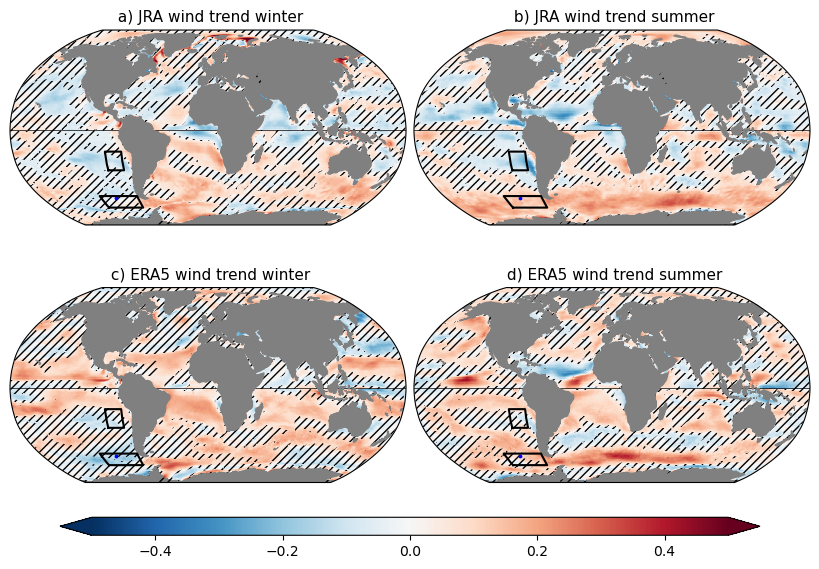

In [23]:
# Figure 4 
mymap=plt.get_cmap('RdBu_r')
mymap.set_bad(color='grey')  # Set color for NaN values
mmax=0.5   # m/s/decade
tabseason=list(dstrends.labsea.values)
#
fig = plt.figure(figsize=(10,6))
#
myvar='uamp_49y'
ilab=[' a) ',' b) ']
for isea in range (2) : 
    ax = fig.add_subplot(2, 2, isea+1, projection=ccrs.Robinson())       
    tabplt = dstrends[myvar].isel(season=isea,parameter=0)
    pcm=plt.pcolormesh(lonplt,latplt,tabplt*10,cmap=mymap,vmin=-mmax,vmax=mmax,
                      transform=ccrs.PlateCarree(),zorder=1)
    ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
    ax.add_feature(cfeature.LAND, edgecolor='grey', facecolor='grey',zorder=2)
    tabstd=dstrends[myvar].isel(parameter=4, season=isea)
    tabmask=np.abs(tabplt) >= tabstd
    ax.contourf(lonplt,latplt, tabmask, levels=[0.,0.1 ], colors='none', hatches=['////'],\
                        alpha=0,transform=ccrs.PlateCarree())    
    plt.title(ilab[isea]+'JRA wind trend '+tabseason[isea],fontsize=11)
    for myreg in regi.keys() :
        tabr=regi[myreg]
        xx=[ tabr[0], tabr[1], tabr[1], tabr[0], tabr[0]]
        yy=[ tabr[2], tabr[2], tabr[3], tabr[3], tabr[2]]
        ax.plot(xx,yy,transform=ccrs.PlateCarree(),color='k')
    ax.scatter(-100, -55,transform=ccrs.PlateCarree(),s=3,marker='o',color='b')
#-----------------------------
# THEN ERA5
#
myvar='era5_U10_49y'
ilab=[' c) ',' d) ']
for isea in range (2) : 
    ax = fig.add_subplot(2, 2, 3+isea, projection=ccrs.Robinson())       
    tabplt = dstrendera[myvar].isel(season=isea,parameter=0)
    pcm=plt.pcolormesh(lonplt,latplt,tabplt*10,cmap=mymap,vmin=-mmax,vmax=mmax,
                      transform=ccrs.PlateCarree(),zorder=1)
    ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
    ax.add_feature(cfeature.LAND, edgecolor='grey', facecolor='grey',zorder=2)
    tabstd=dstrendera[myvar].isel(parameter=4, season=isea)
    tabmask=np.abs(tabplt) >= tabstd
    ax.contourf(lonplt,latplt, tabmask, levels=[0.,0.1 ], colors='none', hatches=['////'],\
                        alpha=0,transform=ccrs.PlateCarree())    
    plt.title(ilab[isea]+'ERA5 wind trend '+tabseason[isea],fontsize=11)
    for myreg in regi.keys() :
        tabr=regi[myreg]
        xx=[ tabr[0], tabr[1], tabr[1], tabr[0], tabr[0]]
        yy=[ tabr[2], tabr[2], tabr[3], tabr[3], tabr[2]]
        ax.plot(xx,yy,transform=ccrs.PlateCarree(),color='k')
    ax.scatter(-100, -55,transform=ccrs.PlateCarree(),s=3,marker='o',color='b')
fig.subplots_adjust(bottom=0.05, top=0.9, left=0.1, right=0.9,
                    wspace=0.02, hspace=0.02)
cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.03])
fig.colorbar(pcm, cax=cbar_ax,orientation='horizontal',extend='both')
plt.show()

fig.savefig('figures/f04_trends_winds_era_jra_reg.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')
fig.savefig('figures/f04_trends_winds_era_jra_reg_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')

## 4.2 Figure S11 for supplémentary material 

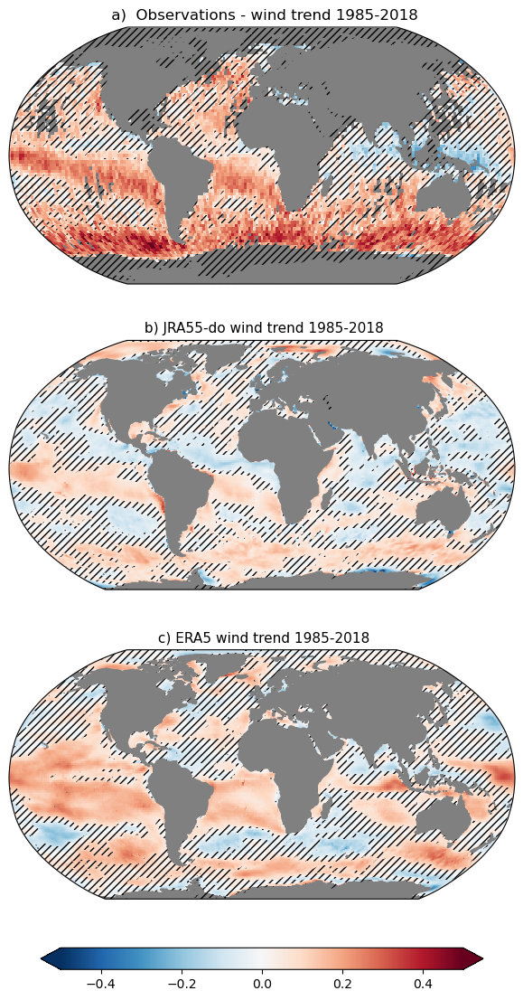

In [24]:
## 
##
##
tabs=ds_young['u10_stat']
tabmasky=xr.where((tabs.isel(param=0) != 0) | (tabs.isel(param=1) != 0) | (tabs.isel(param=2) != 1),0.,1.)
#
mymap=plt.get_cmap('RdBu_r')
mymap.set_bad(color='grey')  # Set color for NaN values
mmax=0.5   # m/s/decade
tabseason=list(dstrends.labsea.values)
#
fig = plt.figure(figsize=(7,12))
ax = fig.add_subplot(3, 1, 1, projection=ccrs.Robinson())  
# Young and Ribal
pcm=plt.pcolormesh(ds_young.lon,ds_young.lat,ds_young['u10_trend'].T,cmap=mymap,vmin=-mmax,vmax=mmax,
                          transform=ccrs.PlateCarree(),zorder=1)
ax.add_feature(cfeature.LAND, edgecolor='grey', facecolor='grey',zorder=2)
ax.contourf(ds_young.lon,ds_young.lat, tabmasky.T, levels=[0.,0.1 ], colors='none', hatches=['////'],\
                    alpha=0,transform=ccrs.PlateCarree())    
plt.title(' a)  Observations - wind trend 1985-2018',fontsize=12)
# JRA first 
ax = fig.add_subplot(3, 1, 2, projection=ccrs.Robinson())  
myvar='uamp_34y'
lonplt=dstrends.lon
latplt=dstrends.lat
# multiply by 10 to have m/s/decade
tabplt = dstrends[myvar].isel(parameter=0)
pcm=plt.pcolormesh(lonplt,latplt,tabplt*10,cmap=mymap,vmin=-mmax,vmax=mmax,
                          transform=ccrs.PlateCarree(),zorder=1)
ax.add_feature(cfeature.LAND, edgecolor='grey', facecolor='grey',zorder=2)
tabstd=dstrends[myvar].isel(parameter=4)
tabmask=np.abs(tabplt) >= tabstd
ax.contourf(lonplt,latplt, tabmask, levels=[0.,0.1 ], colors='none', hatches=['////'],\
                    alpha=0,transform=ccrs.PlateCarree())    
plt.title(' b) JRA55-do wind trend 1985-2018',fontsize=11)
#
#-----------------------------
# THEN ERA5
ax = fig.add_subplot(3, 1, 3, projection=ccrs.Robinson())  
myvar='era5_U10_34y'
lonplt=dstrends.lon
latplt=dstrends.lat
# multiply by 10 to have m/s/decade
tabplt = dstrendera[myvar].isel(parameter=0)  
pcm=plt.pcolormesh(lonplt,latplt,tabplt*10,cmap=mymap,vmin=-mmax,vmax=mmax,
                          transform=ccrs.PlateCarree(),zorder=1)
ax.add_feature(cfeature.LAND, edgecolor='grey', facecolor='grey',zorder=2)
tabstd=dstrendera[myvar].isel(parameter=4)
tabmask=np.abs(tabplt) >= tabstd
ax.contourf(lonplt,latplt, tabmask, levels=[0.,0.1 ], colors='none', hatches=['////'],\
                    alpha=0,transform=ccrs.PlateCarree())    
plt.title(' c) ERA5 wind trend 1985-2018',fontsize=11)
#

fig.subplots_adjust(bottom=0.05, top=0.9, left=0.1, right=0.9,
                    wspace=0.02, hspace=0.02)
cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.02])
fig.colorbar(pcm, cax=cbar_ax,orientation='horizontal',extend='both')
plt.show()

fig.savefig('figures/S11_trends_winds_youg_era_jra_reg.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')
fig.savefig('figures/S11_trends_winds_era_jra_reg_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')

# 5 - trends in MLD, model and observations

Figure 5 and supplementary figures S12 to S15

In [25]:
alltrend=xr.open_dataset(os.environ['HOME']+'/DATA_PAPER_2024/obs_mm_trends_mask_merc1.nc')
alltrend

<xarray.Dataset> Size: 9MB
Dimensions:     (season: 2, lat: 290, lon: 360)
Coordinates:
    labsea      (season) <U6 48B ...
  * lat         (lat) float64 2kB -80.05 -79.71 -79.38 ... 89.05 89.38 89.71
  * lon         (lon) float64 3kB -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
    param_name  <U5 20B ...
Dimensions without coordinates: season
Data variables:
    obs_trend   (season, lat, lon) float64 2MB ...
    obs_mask    (season, lat, lon) bool 209kB ...
    low_trend   (season, lat, lon) float64 2MB ...
    low_mask    (season, lat, lon) int64 2MB ...
    hi_trend    (season, lat, lon) float64 2MB ...
    hi_mask     (season, lat, lon) int64 2MB ...

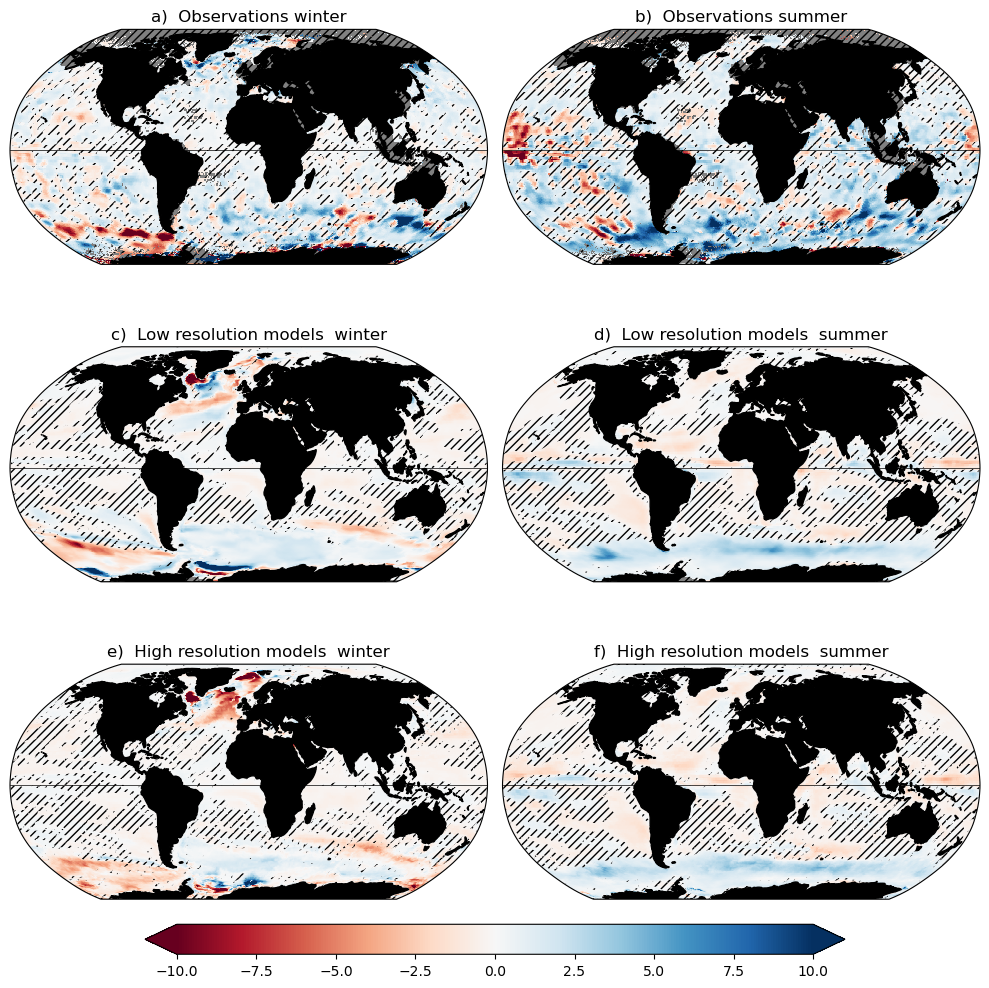

In [26]:
# ATTENTION!  observation trends have an opposite sign
# see Sallée paper. 
mypanel=['a)  ','b)  ','c)  ','d)  ','e)  ','f)  ']  
mmax=[ 50, 10]
lonplt=alltrend.lon.values
latplt=alltrend.lat.values
labsea=alltrend.labsea.values
mymap=plt.get_cmap('RdBu')  # Choose your base colormap
mymap.set_bad(color='grey')  # Set color for NaN values

fig = plt.figure(figsize=(10,10))    
for isea in range (2) : 
#    
    ax = fig.add_subplot(3, 2, isea+1, projection=ccrs.Robinson())
    tabplt=alltrend['obs_trend'].isel(season=isea).squeeze()
    #  change sign for obs 
    mesh=ax.pcolormesh(lonplt,latplt,-tabplt,vmin=-mmax[isea],vmax=mmax[isea],cmap=mymap,
                   transform=ccrs.PlateCarree(),zorder=1)
    ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
    ax.add_feature(cfeature.LAND, edgecolor='black', facecolor='black',zorder=2)
    tabmask=alltrend['obs_mask'].isel(season=isea)
    ax.contourf(lonplt,latplt, tabmask, levels=[0.,0.1 ], colors='none', hatches=['////'],\
                    alpha=0,transform=ccrs.PlateCarree())    
    plt.title(mypanel[isea]+'Observations '+labsea[isea])
# -------------------- LOW RESOLUTION MM mean
#. need to convert in m/decade (*10)
    ax = fig.add_subplot(3, 2, isea+3, projection=ccrs.Robinson())
    tabplt=alltrend['low_trend'].isel(season=isea)*10.
    mesh=ax.pcolormesh(lonplt,latplt,tabplt,vmin=-mmax[isea],vmax=mmax[isea],cmap=mymap,
                   transform=ccrs.PlateCarree(),zorder=1)
    ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
    ax.add_feature(cfeature.LAND, edgecolor='black', facecolor='black',zorder=2)
    tabmask=alltrend['low_mask'].isel(season=isea)
# for the multi model mean, the mask is the sum of the masks. 
# hatch the values of the mask less than 2.5: less than 3 models, half the models are significant.  
    ax.contourf(lonplt,latplt, tabmask, levels=[0., 2.5], colors='none', hatches=['////'],\
                    alpha=0,transform=ccrs.PlateCarree())    
    plt.title(mypanel[isea+2]+'Low resolution models  '+labsea[isea])
# -------------------- HIGH RESOLUTION MM mean
    ax = fig.add_subplot(3, 2, isea+5, projection=ccrs.Robinson())
    tabplt=alltrend['hi_trend'].isel(season=isea)*10.
    mesh=ax.pcolormesh(lonplt,latplt,tabplt,vmin=-mmax[isea],vmax=mmax[isea],cmap=mymap,
                   transform=ccrs.PlateCarree(),zorder=1)
    ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
    ax.add_feature(cfeature.LAND, edgecolor='black', facecolor='black',zorder=2)
    tabmask=alltrend['hi_mask'].isel(season=isea)
# for the multi model mean, the mask is the sum of the masks. 
# hatch the values of the mask less than 2.5: less than 3 models, half the models are significant.  
    ax.contourf(lonplt,latplt, tabmask, levels=[0., 2.5], colors='none', hatches=['////'],\
                    alpha=0,transform=ccrs.PlateCarree())    
    plt.title(mypanel[isea+4]+'High resolution models  '+labsea[isea])
# 
cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.03])
plt.colorbar(mesh,cax=cbar_ax,orientation='horizontal',shrink=0.5,extend='both')
plt.tight_layout()
plt.show()
fig.savefig('figures/f05_trends_MLD.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')
fig.savefig('figures/f05_trends_MLD_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')

## 5.2 trends for individual models 

Figures S12, S13, S14, S15 

In [27]:
# Read lowres trends
#  I am interested only in 6 lowres models (to have low res/high res pairs).
varlow=['NCAR-POP_low','IAP-LICOM_low','CMCC-NEMO_low','ACCESS-MOM_low',\
        'FSU-HYCOM_low','AWI-FESOM_low']
dirlow='/glade/work/treguier/MLD1deg/'
dtmp = xr.open_dataset(dirlow+'eight_models_trends_49years_cycle1_seasons_merc1.nc')
# roll to start at dateline
dtmp=dtmp.roll({'lon':dtmp.sizes['lon'] // 2},roll_coords=True)
dslow=dtmp.assign_coords({'lon':(((dtmp['lon'] + 180) % 360) - 180)}) 
#dslow
# Read higres trends
#  I am interested only in 6 lowres models (to have low res/high res pairs).
varhi=['NCAR-POP_hi','IAP-LICOM_hi','CMCC-NEMO_hi','ACCESS-MOM_hi',\
        'FSU-HYCOM_hi','AWI-FESOM_hi']
dirhi='/glade/work/treguier/MLDhi/'
dtmp = xr.open_dataset(dirhi+'six_models_hires_trends_49years_cycle1_seasons_merc1.nc')
# roll to start at dateline
dtmp=dtmp.roll({'lon':dtmp.sizes['lon'] // 2},roll_coords=True)
dshi=dtmp.assign_coords({'lon':(((dtmp['lon'] + 180) % 360) - 180)}) 
dshi

<xarray.Dataset> Size: 50MB
Dimensions:              (lat: 290, season: 2, lon: 360, parameter: 5)
Coordinates:
  * lat                  (lat) float64 2kB -80.05 -79.71 -79.38 ... 89.38 89.71
    labsea               (season) <U6 48B ...
    param_name           (parameter) <U9 180B ...
  * lon                  (lon) float64 3kB -179.5 -178.5 -177.5 ... 178.5 179.5
Dimensions without coordinates: season, parameter
Data variables:
    NCAR-POP_hi_trend    (season, lat, lon, parameter) float64 8MB -0.09866 ....
    IAP-LICOM_hi_trend   (season, lat, lon, parameter) float64 8MB -1.622 ......
    CMCC-NEMO_hi_trend   (season, lat, lon, parameter) float64 8MB 0.1019 ......
    ACCESS-MOM_hi_trend  (season, lat, lon, parameter) float64 8MB nan ... 0....
    FSU-HYCOM_hi_trend   (season, lat, lon, parameter) float64 8MB -0.04778 ....
    AWI-FESOM_hi_trend   (season, lat, lon, parameter) float64 8MB nan ... 0....

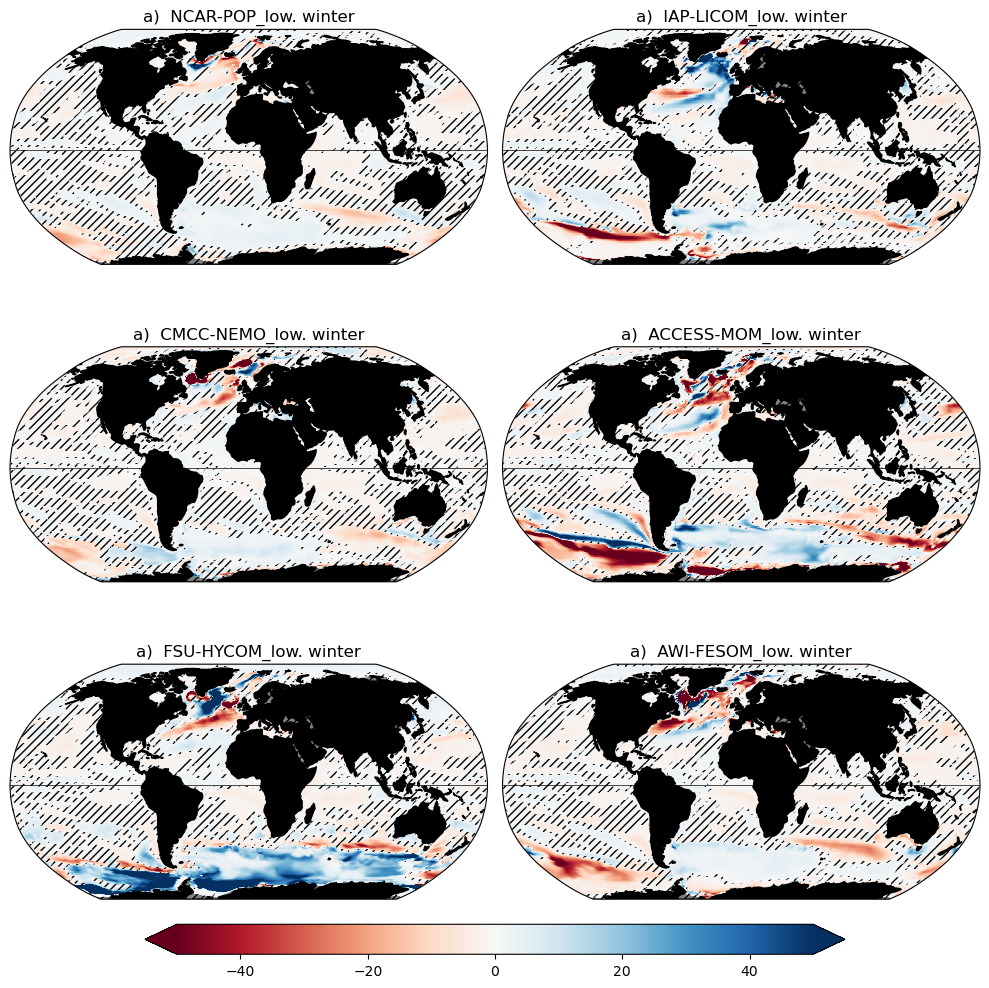

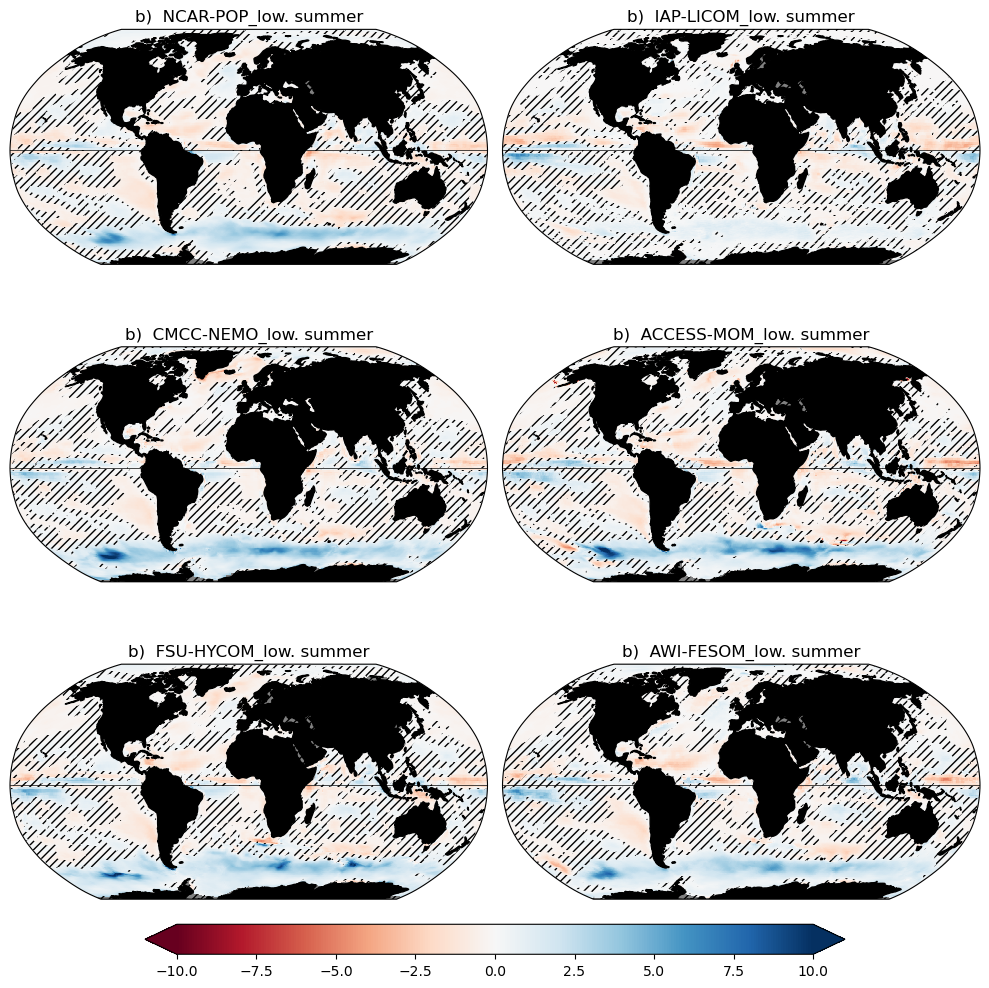

In [28]:
# first low resolution models 
#
mypanel=['a)  ','b)  ','c)  ','d)  ','e)  ','f)  ']  
mmax=[ 50, 10]
lonplt=dslow.lon.values
latplt=dslow.lat.values
labsea=dslow.labsea.values
mymap=plt.get_cmap('RdBu')  # Choose your base colormap
mymap.set_bad(color='grey')  # Set color for NaN values

for isea in range (2) : 
#    
    fig = plt.figure(figsize=(10,10))    
    for imod in range (6) :
        model = varlow[imod]
        ax = fig.add_subplot(3, 2, imod+1, projection=ccrs.Robinson())
        tabplt=dslow[model+'_trend'].isel(season=isea,parameter=0)
        tabstd=dslow[model+'_trend'].isel(season=isea,parameter=4)
        tabmask=np.abs(tabplt) >= tabstd    
        #  
        mesh=ax.pcolormesh(lonplt,latplt,tabplt*10,vmin=-mmax[isea],vmax=mmax[isea],cmap=mymap,
                       transform=ccrs.PlateCarree(),zorder=1)
        ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
        ax.add_feature(cfeature.LAND, edgecolor='black', facecolor='black',zorder=2)
        ax.contourf(lonplt,latplt, tabmask, levels=[0.,0.1 ], colors='none', hatches=['////'],\
                        alpha=0,transform=ccrs.PlateCarree())    
        plt.title(mypanel[isea]+model+'. '+labsea[isea])
   # 
    cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.03])
    plt.colorbar(mesh,cax=cbar_ax,orientation='horizontal',shrink=0.5,extend='both')
    plt.tight_layout()
    plt.show()
    fig.savefig('figures/S'+str(12+isea)+'_trends_MLD_lowres_'+labsea[isea]+'.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')
    fig.savefig('figures/S'+str(12+isea)+'_trends_MLD_lowres_'+labsea[isea]+'_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')

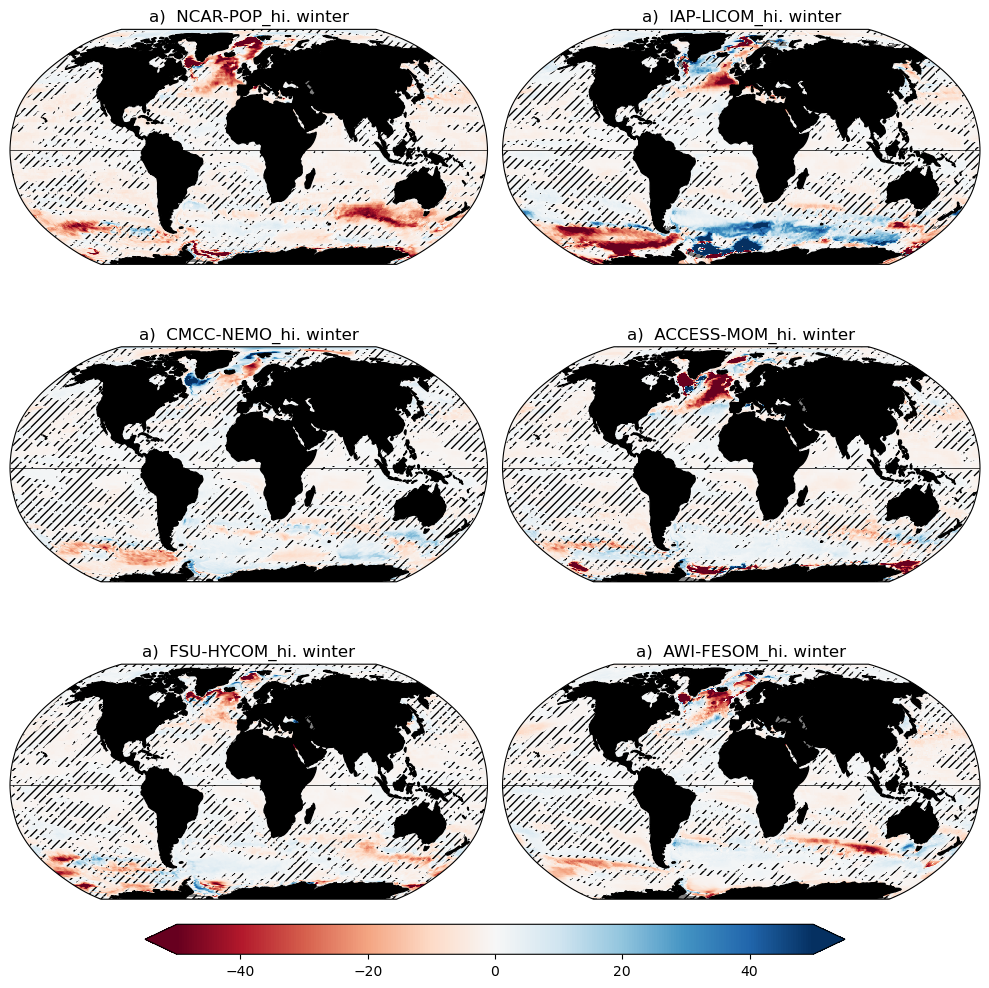

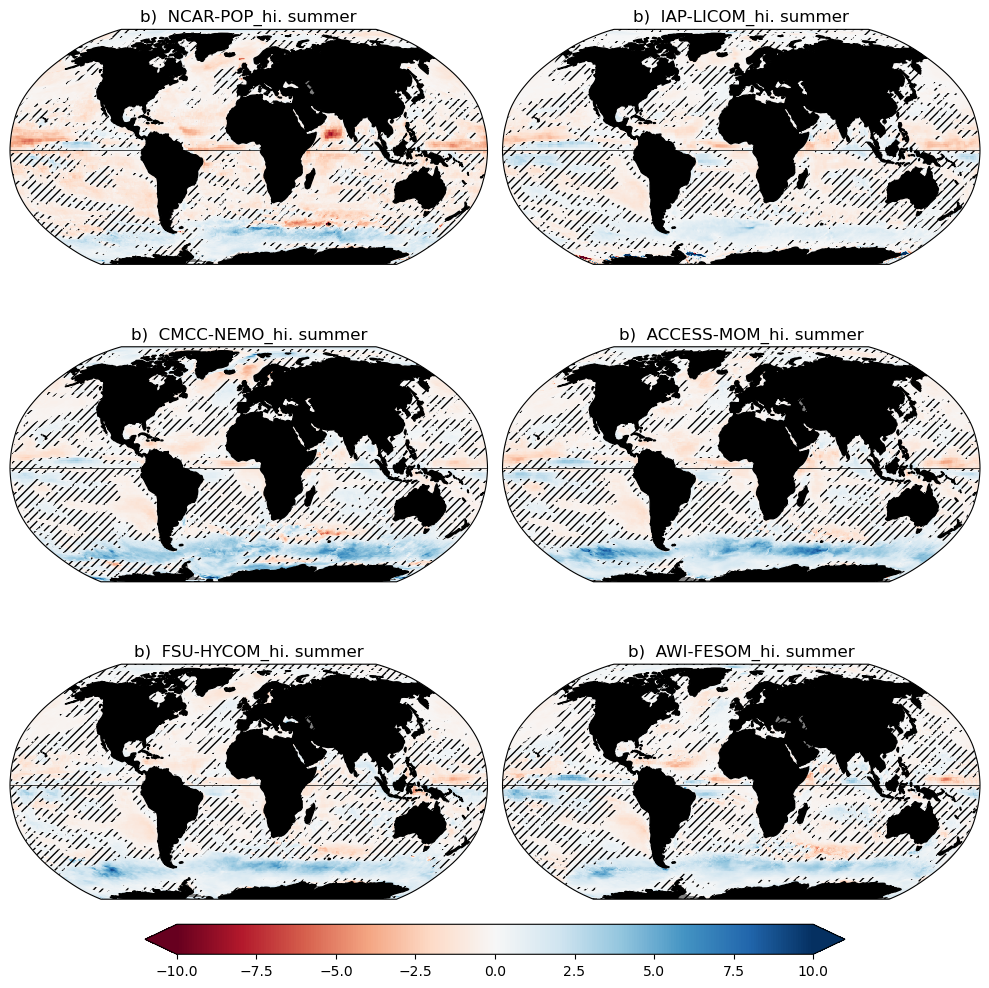

In [29]:
# Second, high  resolution models 
#
mypanel=['a)  ','b)  ','c)  ','d)  ','e)  ','f)  ']  
mmax=[ 50, 10]
lonplt=dshi.lon.values
latplt=dshi.lat.values
labsea=dshi.labsea.values
mymap=plt.get_cmap('RdBu')  # Choose your base colormap
mymap.set_bad(color='grey')  # Set color for NaN values

for isea in range (2) : 
#    
    fig = plt.figure(figsize=(10,10))    
    for imod in range (6) :
        model = varhi[imod]
        ax = fig.add_subplot(3, 2, imod+1, projection=ccrs.Robinson())
        tabplt=dshi[model+'_trend'].isel(season=isea,parameter=0)
        tabstd=dshi[model+'_trend'].isel(season=isea,parameter=4)
        tabmask=np.abs(tabplt) >= tabstd    
        #  
        mesh=ax.pcolormesh(lonplt,latplt,tabplt*10,vmin=-mmax[isea],vmax=mmax[isea],cmap=mymap,
                       transform=ccrs.PlateCarree(),zorder=1)
        ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
        ax.add_feature(cfeature.LAND, edgecolor='black', facecolor='black',zorder=2)
        ax.contourf(lonplt,latplt, tabmask, levels=[0.,0.1 ], colors='none', hatches=['////'],\
                        alpha=0,transform=ccrs.PlateCarree())    
        plt.title(mypanel[isea]+model+'. '+labsea[isea])
   # 
    cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.03])
    plt.colorbar(mesh,cax=cbar_ax,orientation='horizontal',shrink=0.5,extend='both')
    plt.tight_layout()
    plt.show()
    fig.savefig('figures/S'+str(14+isea)+'_trends_MLD_hires_'+labsea[isea]+'.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')
    fig.savefig('figures/S'+str(14+isea)+'_trends_MLD_hires_'+labsea[isea]+'_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')

#   6 - Figure for time series in two regions and for NEMO1D

figure 6 

In [30]:
dstime=xr.open_dataset(dirin+'Time_series_seasons_2regions_mld_models_wind.nc')
nemo1d=xr.open_dataset(dirin+'nemo1d_results_v1.nc')
nemo1d

<xarray.Dataset> Size: 2kB
Dimensions:       (time: 49, season: 2)
Coordinates:
    nav_lat       float32 4B ...
    nav_lon       float32 4B ...
  * time          (time) int64 392B 1970 1971 1972 1973 ... 2015 2016 2017 2018
    labsea        (season) <U6 48B ...
    lat           float64 8B ...
    lon           float64 8B ...
Dimensions without coordinates: season
Data variables:
    mld1d_init    (season, time) float32 392B ...
    mld1d_noinit  (season, time) float32 392B ...
    mld1d_clim    (season, time) float32 392B ...
    mld_CMCC      (season, time) float64 784B ...

In [31]:
dstime

<xarray.Dataset> Size: 22kB
Dimensions:         (time: 49, region: 2, season: 2)
Coordinates:
  * time            (time) int64 392B 1970 1971 1972 1973 ... 2016 2017 2018
    labsea          <U6 24B ...
    regname         (region) <U5 40B ...
Dimensions without coordinates: region, season
Data variables: (12/14)
    NCAR-POP_low    (region, season, time) float64 2kB ...
    IAP-LICOM_low   (region, season, time) float64 2kB ...
    CMCC-NEMO_low   (region, season, time) float64 2kB ...
    ACCESS-MOM_low  (region, season, time) float64 2kB ...
    FSU-HYCOM_low   (region, season, time) float64 2kB ...
    AWI-FESOM_low   (region, season, time) float64 2kB ...
    ...              ...
    CMCC-NEMO_hi    (region, season, time) float64 2kB ...
    ACCESS-MOM_hi   (region, season, time) float64 2kB ...
    FSU-HYCOM_hi    (region, season, time) float64 2kB ...
    AWI-FESOM_hi    (region, season, time) float64 2kB ...
    multimodel      (region, season, time) float64 2kB ...
    uamp_jra        (region, season, time) float64 2kB ...

In [32]:
# plot time series of MLD ans winds in summer
# three panels: SEPAC, EPSO and 1d
# PROBLEM: no labsea in dstime dataset - redefine labels for seasons
tabsea=['winter','summer']
print(dstime.regname.values)

['SEPAC' 'EPSO']


In [33]:
newvarhi=['NCAR-POP_hi','IAP-LICOM_hi','CMCC-NEMO_hi','ACCESS-MOM_hi',\
        'FSU-HYCOM_hi','AWI-FESOM_hi']
varlow=['NCAR-POP_low','IAP-LICOM_low','CMCC-NEMO_low','ACCESS-MOM_low',\
        'FSU-HYCOM_low','AWI-FESOM_low']
allvars=varlow+newvarhi

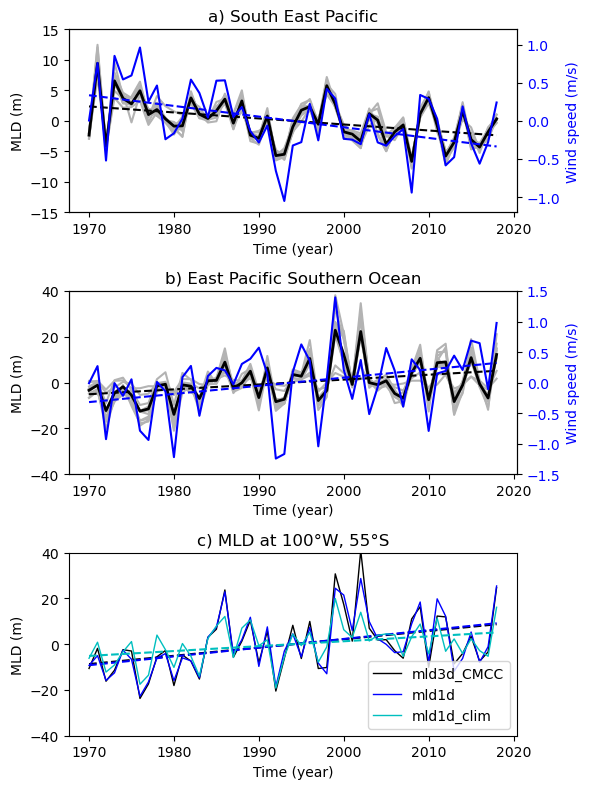

In [36]:
#  Summer season: figure 6

listreg=['SEPAC','EPSO']
longnamreg = ['South East Pacific','East Pacific Southern Ocean' ]
#   variables for 1d model 
varlist=['mld_CMCC','mld1d_init','mld1d_clim']
varlabel=['mld3d_CMCC','mld1d','mld1d_clim']
#     
colw='b'
fig = plt.figure(figsize=(6,8))  
timtab=dstime.time
spanel=['a) ','b) ','c) ']
# choose summer 
isea=1
for ireg in range(2) :
    mldmax=[ 40, 15]
    umax=[ 1.2, 1.2]
    if ireg == 1 :
        mldmax=[ 250, 40]
        umax=[ 1.7, 1.5]
    ax = fig.add_subplot(3, 1, ireg+1)
    for ii,ivar in enumerate(allvars) :
    #         tabplt=dstime[ivar].isel(season=isea,region=ireg)
        tabplt=dstime[ivar].isel(season=isea,region=ireg)-dstime[ivar].isel(season=isea,region=ireg).mean('time')
        plt.plot(timtab,tabplt,color=[0.7,0.7,0.7])
    tabplt=dstime['multimodel'].isel(season=isea,region=ireg)-dstime['multimodel'].isel(season=isea,region=ireg).mean('time')
    plt.plot(timtab,tabplt,'k',linewidth=2)
    slope, intercept, r_value, p_value, std_err = stats.linregress(timtab, tabplt)
    plt.plot(timtab,intercept+slope*timtab,'k--')
    ax.set_ylim([-mldmax[isea],mldmax[isea]])
    ax.set_ylabel('MLD (m)')
    plt.title(spanel[ireg]+longnamreg[ireg])
    tabplt=dstime['uamp_jra'].isel(season=isea,region=ireg)-dstime['uamp_jra'].isel(season=isea,region=ireg).mean('time')
    ax2 = ax.twinx()    
    ax2.tick_params(axis='y', labelcolor=colw)
    ax2.set_ylim([-umax[isea],umax[isea]])
    ax2.plot(timtab,tabplt,colw)
    slope, intercept, r_value, p_value, std_err = stats.linregress(timtab, tabplt)
    plt.plot(timtab,intercept+slope*timtab,colw+'--')
    ax2.set_ylabel('Wind speed (m/s)',color=colw)
    ax.set_xlabel('Time (year)')
# add 1d model 
slopes=np.zeros((3))
mycols=['k','b','c']
mylines=[ 1, 1, 1]
timyear=nemo1d.time.values
ax = fig.add_subplot(3, 1, 3)
plt.title(spanel[2]+'MLD at 100°W, 55°S')
for ii,var in enumerate(varlist) :
    tabplt=nemo1d[var].isel(season=isea)
    tabplt=tabplt-tabplt.mean('time')
    p = tabplt.polyfit(dim='time', deg=1)
    slopes[ii]=p.polyfit_coefficients[0]
    fit = xr.polyval(nemo1d[var].time, p.polyfit_coefficients)
    plt.plot(timyear,tabplt,color=mycols[ii],linewidth=mylines[ii])
    plt.plot(timyear,fit,color=mycols[ii],linestyle='--',label='_nolegend_')
ax.set_ylabel('MLD (m)')
ax.set_xlabel('Time (year)')
ax.set_ylim([-40,40])
plt.legend(varlabel,loc='lower right')
#
fig.tight_layout()
plt.show()
fig.savefig('figures/f06_2reg1d.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')
fig.savefig('figures/f06_2reg1d_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')

In [37]:
#  print means 
isea=1
for ii, var in enumerate(varlist) :
    print(var,' mean MLD:',nemo1d[var].isel(season=isea).mean().values, 'slope:',slopes[ii])

mld_CMCC  mean MLD: 65.77707101212067 slope: 0.3620374427847288
mld1d_init  mean MLD: 75.826904 slope: 0.3823002811354007
mld1d_clim  mean MLD: 75.61225 slope: 0.21357839740052417


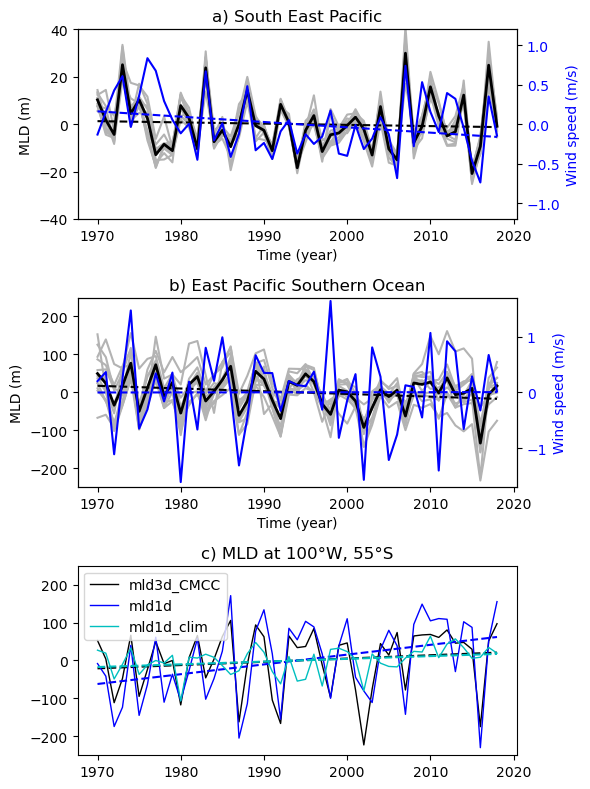

In [38]:
#   Supplementary FIGURE S16
#   same for winter 
listreg=['SEPAC','EPSO']
longnamreg = ['South East Pacific','East Pacific Southern Ocean' ]
#   variables for 1d model 
varlist=['mld_CMCC','mld1d_init','mld1d_clim']
varlabel=['mld3d_CMCC','mld1d','mld1d_clim']
#     
colw='b'
fig = plt.figure(figsize=(6,8))  
timtab=dstime.time
spanel=['a) ','b) ','c) ']
# choose summer 
isea=0
for ireg in range(2) :
    mldmax=[ 40, 15]
    umax=[ 1.2, 1.2]
    if ireg == 1 :
        mldmax=[ 250, 40]
        umax=[ 1.7, 1.5]
    ax = fig.add_subplot(3, 1, ireg+1)
    for ii,ivar in enumerate(allvars) :
    #         tabplt=dstime[ivar].isel(season=isea,region=ireg)
        tabplt=dstime[ivar].isel(season=isea,region=ireg)-dstime[ivar].isel(season=isea,region=ireg).mean('time')
        plt.plot(timtab,tabplt,color=[0.7,0.7,0.7])
    tabplt=dstime['multimodel'].isel(season=isea,region=ireg)-dstime['multimodel'].isel(season=isea,region=ireg).mean('time')
    plt.plot(timtab,tabplt,'k',linewidth=2)
    slope, intercept, r_value, p_value, std_err = stats.linregress(timtab, tabplt)
    plt.plot(timtab,intercept+slope*timtab,'k--')
    ax.set_ylim([-mldmax[isea],mldmax[isea]])
    ax.set_ylabel('MLD (m)')
    plt.title(spanel[ireg]+longnamreg[ireg])
    tabplt=dstime['uamp_jra'].isel(season=isea,region=ireg)-dstime['uamp_jra'].isel(season=isea,region=ireg).mean('time')
    ax2 = ax.twinx()    
    ax2.tick_params(axis='y', labelcolor=colw)
    ax2.set_ylim([-umax[isea],umax[isea]])
    ax2.plot(timtab,tabplt,colw)
    slope, intercept, r_value, p_value, std_err = stats.linregress(timtab, tabplt)
    plt.plot(timtab,intercept+slope*timtab,colw+'--')
    ax2.set_ylabel('Wind speed (m/s)',color=colw)
    ax.set_xlabel('Time (year)')
# add 1d model 
slopes=np.zeros((3))
mycols=['k','b','c']
mylines=[ 1, 1, 1]
timyear=nemo1d.time.values
ax = fig.add_subplot(3, 1, 3)
plt.title(spanel[2]+'MLD at 100°W, 55°S')
for ii,var in enumerate(varlist) :
    tabplt=nemo1d[var].isel(season=isea)
    tabplt=tabplt-tabplt.mean('time')
    p = tabplt.polyfit(dim='time', deg=1)
    slopes[ii]=p.polyfit_coefficients[0]
    fit = xr.polyval(nemo1d[var].time, p.polyfit_coefficients)
    plt.plot(timyear,tabplt,color=mycols[ii],linewidth=mylines[ii])
    plt.plot(timyear,fit,color=mycols[ii],linestyle='--',label='_nolegend_')
ax.set_ylim([-mldmax[isea],mldmax[isea]])
plt.legend(varlabel,loc='upper left')
#
fig.tight_layout()
plt.show()
fig.savefig('figures/S16_2reg1d.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')
fig.savefig('figures/S16_2reg1d_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0), bbox_inches='tight')

In [39]:
#  print means 
isea=0
for ii, var in enumerate(varlist) :
    print(var,' mean MLD:',nemo1d[var].isel(season=isea).mean().values, 'slope:',slopes[ii])

mld_CMCC  mean MLD: 433.8878435407367 slope: 0.8654293200434175
mld1d_init  mean MLD: 408.43524 slope: 2.582594968834676
mld1d_clim  mean MLD: 402.44412 slope: 0.7200943273427323


# 7 - Trends over 2006-2018 to compare with Roch et al, 2023

supplementary figure 17 

In [40]:
alltrend=xr.open_dataset(os.environ['HOME']+'/DATA_PAPER_2024/mm12_2006_trends_mask_merc1.nc')
alltrend

<xarray.Dataset> Size: 3MB
Dimensions:     (lat: 290, season: 2, lon: 360)
Coordinates:
  * lat         (lat) float64 2kB -80.05 -79.71 -79.38 ... 89.05 89.38 89.71
    labsea      (season) <U6 48B ...
    param_name  <U5 20B ...
  * lon         (lon) float64 3kB -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
Dimensions without coordinates: season
Data variables:
    all_trend   (season, lat, lon) float64 2MB ...
    all_mask    (season, lat, lon) int64 2MB ...

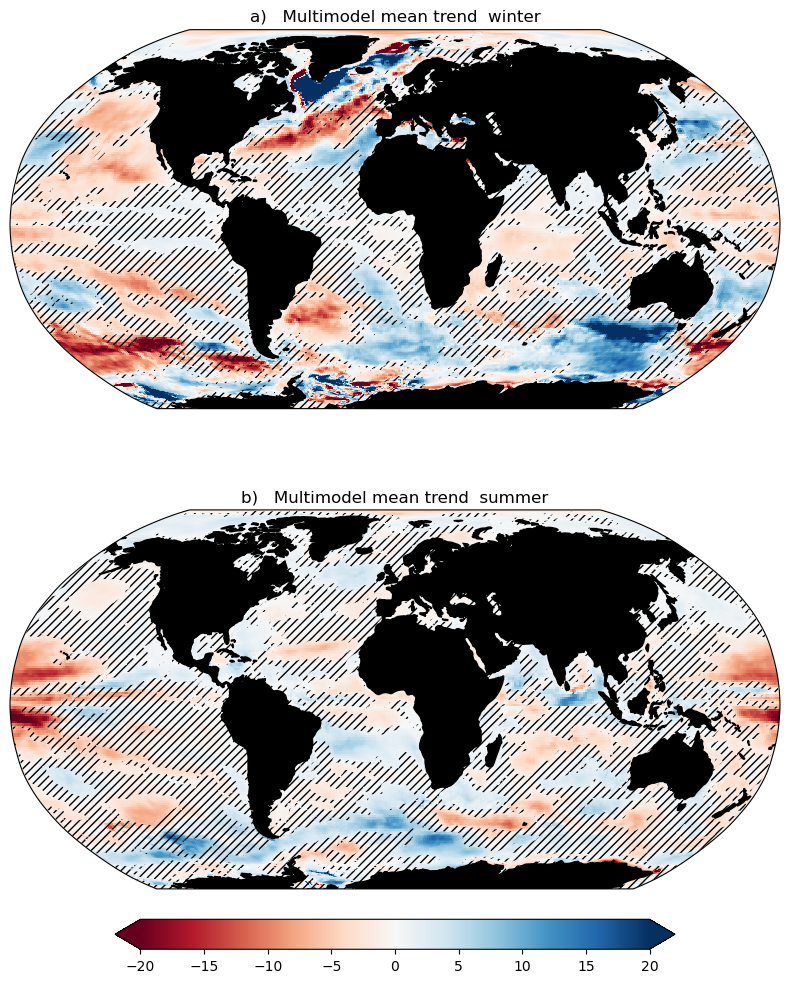

In [41]:
# Multimodel trend, winter and summer. 
#
mypanel=['a)  ','b)  ']

mmax=[ 50, 20 ]
lonplt=alltrend.lon.values
latplt=alltrend.lat.values
labsea=alltrend.labsea.values
mymap=plt.get_cmap('RdBu')  # Choose your base colormap
mymap.set_bad(color='grey')  # Set color for NaN values

fig = plt.figure(figsize=(8,10))    
for isea in range (2) : 
#    
    ax = fig.add_subplot(2, 1, isea+1, projection=ccrs.Robinson())
# --------------------  MM mean
#. need to convert in m/decade (*10)
    tabplt=alltrend['all_trend'].isel(season=isea)*10.
    mesh=ax.pcolormesh(lonplt,latplt,tabplt,vmin=-mmax[isea],vmax=mmax[isea],cmap=mymap,
                   transform=ccrs.PlateCarree(),zorder=1)
    ax.add_feature(cfeature.LAND, edgecolor='black', facecolor='black',zorder=2)
    tabmask=alltrend['all_mask'].isel(season=isea)
# for the multi model mean, the mask is the sum of the masks. 
# hatch the values of the mask less than 3.5: less than 4 models, meaning one third the models are significant.  
    ax.contourf(lonplt,latplt, tabmask, levels=[0., 3.5], colors='none', hatches=['////'],\
                    alpha=0,transform=ccrs.PlateCarree())    
    plt.title(mypanel[isea]+' Multimodel mean trend  '+labsea[isea])
# 
cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.03])
plt.colorbar(mesh,cax=cbar_ax,orientation='horizontal',shrink=0.5,extend='both')
plt.tight_layout()
plt.show()

fig.savefig('figures/s17_trends_MLD_2006.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')
fig.savefig('figures/s17_trends_MLD_2006_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')

#  8 - REVISION of paper : OMIP1 models

## Figure S18: CORE-OMIP1 forcing trends compared with JRA
period is 1970-2009 (40 years)

In [42]:
dtmp=xr.open_dataset(os.environ['HOME']+'/DATA_PAPER_2024/JRA_uamp_trends_merc1.nc')
dtmp=dtmp.roll({'lon':dtmp.sizes['lon'] // 2},roll_coords=True)
dstrends=dtmp.assign_coords({'lon':(((dtmp['lon'] + 180) % 360) - 180)}) 
#
dtmp=xr.open_dataset(os.environ['HOME']+'/DATA_PAPER_2024/uwind_omip1_trends_40years_cycle1_seasons.nc')
dtmp=dtmp.roll({'lon':dtmp.sizes['lon'] // 2},roll_coords=True)
dstrends1=dtmp.assign_coords({'lon':(((dtmp['lon'] + 180) % 360) - 180)}) 

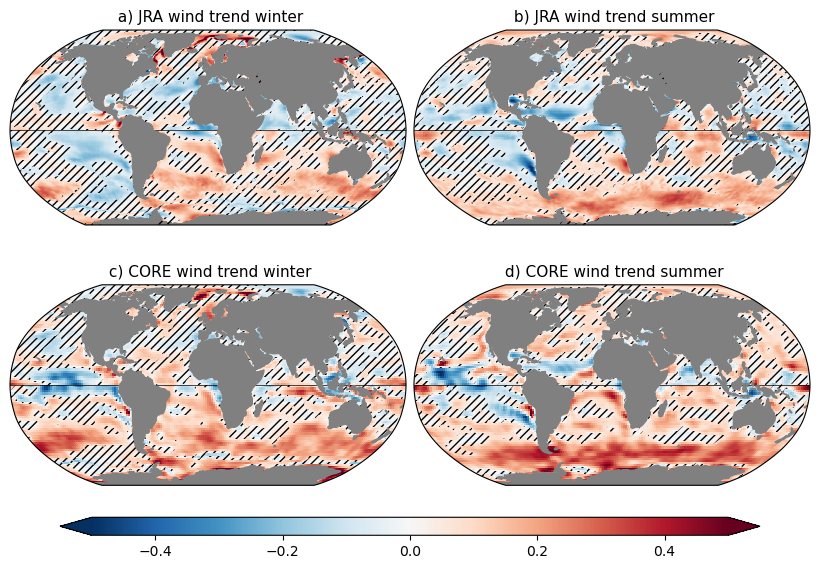

In [43]:
# Figure 4 
mymap=plt.get_cmap('RdBu_r')
mymap.set_bad(color='grey')  # Set color for NaN values
mmax=0.5   # m/s/decade
tabseason=list(dstrends.labsea.values)
#
fig = plt.figure(figsize=(10,6))
#
myvar='uamp_40y'
ilab=[' a) ',' b) ']
for isea in range (2) : 
    ax = fig.add_subplot(2, 2, isea+1, projection=ccrs.Robinson())       
    tabplt = dstrends[myvar].isel(season=isea,parameter=0)
    pcm=plt.pcolormesh(tabplt.lon,tabplt.lat,tabplt*10,cmap=mymap,vmin=-mmax,vmax=mmax,
                      transform=ccrs.PlateCarree(),zorder=1)
    ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
    ax.add_feature(cfeature.LAND, edgecolor='grey', facecolor='grey',zorder=2)
    tabstd=dstrends[myvar].isel(parameter=4, season=isea)
    tabmask=np.abs(tabplt) >= tabstd
    ax.contourf(tabplt.lon,tabplt.lat, tabmask, levels=[0.,0.1 ], colors='none', hatches=['////'],\
                        alpha=0,transform=ccrs.PlateCarree())    
    plt.title(ilab[isea]+'JRA wind trend '+tabseason[isea],fontsize=11)
#-----------------------------
# THEN CORE
#
myvar='uamp_10_trend'
ilab=[' c) ',' d) ']
for isea in range (2) : 
    ax = fig.add_subplot(2, 2, 3+isea, projection=ccrs.Robinson())       
    tabplt = dstrends1[myvar].isel(season=isea,parameter=0)
    pcm=plt.pcolormesh(tabplt.lon,tabplt.lat,tabplt*10,cmap=mymap,vmin=-mmax,vmax=mmax,
                      transform=ccrs.PlateCarree(),zorder=1)
    ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
    ax.add_feature(cfeature.LAND, edgecolor='grey', facecolor='grey',zorder=2)
    tabstd=dstrends1[myvar].isel(parameter=4, season=isea)
    tabmask=np.abs(tabplt) >= tabstd
    ax.contourf(tabplt.lon,tabplt.lat, tabmask, levels=[0.,0.1 ], colors='none', hatches=['////'],\
                        alpha=0,transform=ccrs.PlateCarree())    
    plt.title(ilab[isea]+'CORE wind trend '+tabseason[isea],fontsize=11)
fig.subplots_adjust(bottom=0.05, top=0.9, left=0.1, right=0.9,
                    wspace=0.02, hspace=0.02)
cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.03])
fig.colorbar(pcm, cax=cbar_ax,orientation='horizontal',extend='both')
plt.show()

fig.savefig('figures/fsup_trends_winds_ncep_jra_reg.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')
fig.savefig('figures/fsup_trends_winds_ncep_jra_reg_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')

In [44]:
# average trend in latitude band 50-60
tabplt=dstrends['uamp_40y'].isel(parameter=0).mean('lon').sel(lat=slice(-60,-50))*10.
weights = np.cos(np.deg2rad(tabplt.lat))
print('JRA55 50-60S:',tabplt.weighted(weights).mean('lat').values)
tabplt=dstrends1['uamp_10_trend'].isel(parameter=0).mean('lon').sel(lat=slice(-60,-50))*10.
weights = np.cos(np.deg2rad(tabplt.lat))
print('CORE 50-60S:',tabplt.weighted(weights).mean('lat').values)

JRA55 50-60S: [0.04012863 0.17287928]
CORE 50-60S: [0.13698981 0.27921651]


##  Figure S19: Trends for three OMIP1 models 

In [45]:
#  read trends 
#
dtmp=xr.open_dataset(os.environ['HOME']+'/DATA_PAPER_2024/three_models_omip1_trends_40years_cycle1_seasons_merc1.nc')
dtmp=dtmp.roll({'lon':dtmp.sizes['lon'] // 2},roll_coords=True)
dslowtrend=dtmp.assign_coords({'lon':(((dtmp['lon'] + 180) % 360) - 180)}) 
allvars=list(dslowtrend.data_vars)
nvars=len(allvars)
newvar=['NCAR-POP_low','IAP-LICOM_low','CMCC-NEMO_low']
print(allvars)

['NCAR-POP_low_trend', 'IAP-LICOM_low_trend', 'CMCC-NEMO_low_trend']


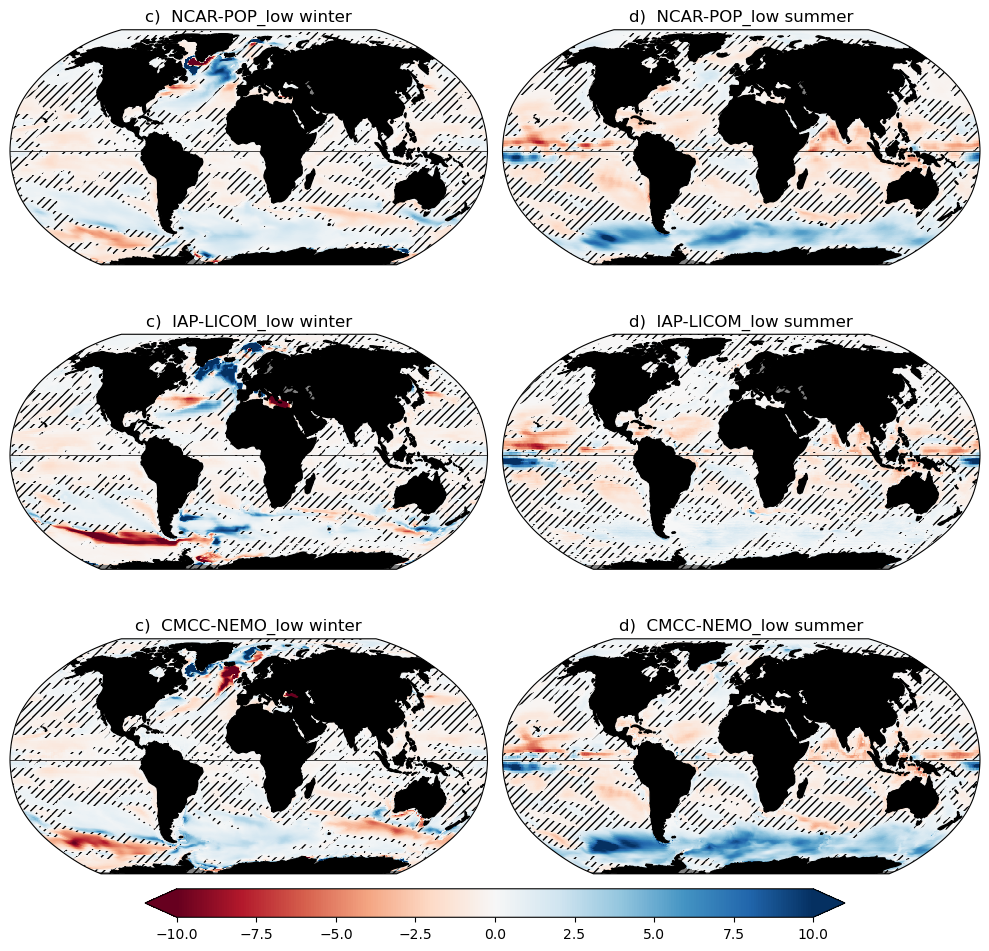

In [46]:
# plots
mypanel=['a)  ','b)  ','c)  ','d)  ','e)  ','f)  ']  
mmax=[ 50, 10]
lonplt=dslowtrend.lon.values
latplt=dslowtrend.lat.values
labsea=dslowtrend.labsea.values
mymap=plt.get_cmap('RdBu')  # Choose your base colormap
mymap.set_bad(color='grey')  # Set color for NaN values

fig = plt.figure(figsize=(10,9.5))    
for isea in range (2) : 
#    
# -------------------- LOW RESOLUTION MM mean
# need to convert in m/decade (*10)
    for imod in range(3) :
        ax = fig.add_subplot(3,2, isea+2*imod+1, projection=ccrs.Robinson())
        tabplt=dslowtrend[allvars[imod]].isel(season=isea,parameter=0)
        tabstd=dslowtrend[allvars[imod]].isel(season=isea,parameter=4)
        tabmask=np.abs(tabplt) >= tabstd    
        mesh=ax.pcolormesh(lonplt,latplt,tabplt*10,vmin=-mmax[isea],vmax=mmax[isea],cmap=mymap,
                       transform=ccrs.PlateCarree(),zorder=1)
        ax.plot([ -180,180],[0,0],linewidth=0.5,color='k',transform = ccrs.PlateCarree())
        ax.add_feature(cfeature.LAND, edgecolor='black', facecolor='black',zorder=2)
        ax.contourf(lonplt,latplt, tabmask, levels=[0.,0.1 ], colors='none', hatches=['////'],\
                        alpha=0,transform=ccrs.PlateCarree())    
        plt.title(mypanel[isea+2]+newvar[imod]+' '+labsea[isea])
# 
cbar_ax = fig.add_axes([0.15, 0.01, 0.7, 0.03])
plt.colorbar(mesh,cax=cbar_ax,orientation='horizontal',shrink=0.5,extend='both')
plt.tight_layout()
plt.show()
fig.savefig('figures/fsupp_trends_MLD_OMIP1_2009.png',dpi=300,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')
fig.savefig('figures/fsupp_trends_MLD_OMIP1_2009_lowres.png',dpi=100,facecolor=(1.0, 1.0, 1.0, 1.0),bbox_inches='tight')

In [47]:
for isea in range (2) : 
    for imod in range(3) :
        tabplt=dslowtrend[allvars[imod]].isel(season=isea,parameter=0)
        tabplt =tabplt.mean('lon').sel(lat=slice(-60,-50))*10.
        weights = np.cos(np.deg2rad(tabplt.lat))
        print(labsea[isea],'-',newvar[imod],tabplt.weighted(weights).mean('lat').values)

winter - NCAR-POP_low 1.5713912130780356
winter - IAP-LICOM_low -5.933219955145576
winter - CMCC-NEMO_low -1.435006067555023
summer - NCAR-POP_low 3.2363542787500212
summer - IAP-LICOM_low 0.575496916660569
summer - CMCC-NEMO_low 4.087009858863052
